In [1]:
%load_ext autoreload
%autoreload 2

# 3rd party imports
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import pandas as pd
np.set_printoptions(linewidth=1000)

from scipy.optimize import minimize, LinearConstraint, NonlinearConstraint


# Local imports
import modules.laplacian as laplacian
import modules.jacobian as jacobian
import modules.correspondences as correspondences

import time

In [2]:
# Define global var
threshold = 0.01
max_iter = 1000000

list_dev = []
num_neg_jac_init = []
num_neg_jac = []
time_taken = []
full_start = time.time()

## Full SLSQP

In [3]:
# Define the objective function
def objective(phi, phi_init, A_, b_):
    return np.linalg.norm(A_ @ phi - b_)**2

# Define the objective function

def objectiveEuc(phi, phi_init, A_, b_):
    return np.linalg.norm(phi - phi_init)

def objectiveEuc2(phi, phi_init, A_, b_):
    return np.linalg.norm(phi - phi_init) + np.linalg.norm(A_ @ phi - b_)

def objectiveManh(phi, phi_init, A_, b_):
    return np.linalg.norm(phi - phi_init, ord=1)

def objectiveManh2(phi, phi_init, A_, b_):
    return np.linalg.norm(phi - phi_init, ord=1) + np.linalg.norm(A_ @ phi - b_)


In [4]:
# jacobian functions

def jacobian_det2D(phi_xy):
    deformation = np.zeros((3,1, *phi_xy.shape[-2:]))
    deformation[2] = phi_xy[1]
    deformation[1] = phi_xy[0]
    return jacobian.sitk_jacobian_determinant(deformation)

def jacobian_constraint(phi_xy, slice_shape, y_offset):
    deformation = np.zeros((3,1, *slice_shape[-2:]))
    deformation[2] = phi_xy[:y_offset].reshape((slice_shape[2], slice_shape[3]))
    deformation[1] = phi_xy[y_offset:].reshape((slice_shape[2], slice_shape[3]))    
    return jacobian.sitk_jacobian_determinant(deformation).flatten()

In [5]:
def full_slsqp(deformation_i, methodName='SLSQP'):
    '''perform SLSQP on full image'''
    time_start = time.time()

    slice_shape = deformation_i.shape

    # this phi will be updated iteratively
    phi_init = np.zeros((2, *deformation_i.shape[-2:]))
    phi_init[1] = deformation_i[-1]
    phi_init[0] = deformation_i[-2]
    print(f'deformation_i shape: {deformation_i.shape}, phi_init shape: {phi_init.shape}')
    
    phi_init_flat = np.concatenate([phi_init[1].flatten(), phi_init[0].flatten()])
    phi = phi_init.copy()

    # collect indices with -ve Jacobians into a list in a sorted fashion
    J_init = jacobian_det2D(phi_init)
    
    y_offset = J_init.size

    nonlinear_constraints = NonlinearConstraint(lambda phi1: jacobian_constraint(phi1, slice_shape, y_offset), threshold, np.inf)
    constraints=nonlinear_constraints

    _, A_, b_ = laplacian.compute3DLaplacianFromShape(slice_shape, np.empty((0,3)), np.empty((0,3)))

    result = minimize(lambda phi1: objectiveEuc(phi1, phi_init_flat, A_, b_), phi_init_flat, constraints=constraints, options={'maxiter': max_iter, 'disp': True}, method=methodName)
    if result.success:
        print(f'OP result error: {result.fun}')
    else:
        print("Optimisation failed: ", result.message)


    phi[1] = result.x[:len(result.x) // 2].reshape(slice_shape[-2:])
    phi[0] = result.x[len(result.x) // 2:].reshape(slice_shape[-2:])

    J_final = jacobian_det2D(phi)
    jacobians = [J_init, J_final]

    deviation = np.sqrt(np.sum((phi - phi_init)**2))

    print(f'Deviation from initial = {deviation}')
    print(f'Changed number of -ve jacobians from {(J_init<=0).sum()} to {(J_final<=0).sum()}')

    time_end = time.time()
    print(f'Time taken for full SLSQP optimisation: {time_end-time_start}s')

    # add to global var list
    list_dev.append(deviation)
    num_neg_jac_init.append((J_init<=0).sum())
    num_neg_jac.append((J_final<=0).sum())
    time_taken.append(time_end-time_start)

    return phi, jacobians

## preprocessing and plotting methods

In [6]:
def plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10)):
    jacobian_initial = jacobian_det2D(deformation_i[1:])
    jacobian_final = jacobian_det2D(phi_corrected)

    # print("JACOBIAN SHAPES", jacobian_initial.shape, jacobian_final.shape)

    # Create DataFrame
    data = {
        ("x-def", "min"): [np.min(deformation_i[2,0]), np.min(phi_corrected[1])],
        ("x-def", "max"): [np.max(deformation_i[2,0]), np.max(phi_corrected[1])],
        ("y-def", "min"): [np.min(deformation_i[1,0]), np.min(phi_corrected[0])],
        ("y-def", "max"): [np.max(deformation_i[1,0]), np.max(phi_corrected[0])],
        ("jacobian", "min"): [np.min(jacobian_initial), np.min(jacobian_final)],
        ("jacobian", "max"): [np.max(jacobian_initial), np.max(jacobian_final)]
    }

    row_names = ["initial", "final"]
    df = pd.DataFrame(data, index=row_names)

    # Print table
    print(df)


    # plot initial vs final Jacobian
    norm = mcolors.TwoSlopeNorm(vmin=min(jacobian_initial.min(), jacobian_final.min(), -1), vcenter=0, vmax=max(jacobian_initial.max(), jacobian_final.max(), 1))


    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=figsize)

    # jacobians are of shape (1,5,5). Use index [0] for 2D plots
    im0 = axs[0,0].imshow(jacobian_initial[0], cmap='seismic', norm=norm, interpolation='nearest')
    im1 = axs[0,1].imshow(jacobian_final[0], cmap='seismic', norm=norm, interpolation='nearest')

    for i in range(len(msample)):  # Draw lines connecting the points
        axs[0,0].annotate(
            '', 
            xy=(fsample[i][2], fsample[i][1]), 
            xytext=(msample[i][2], msample[i][1]), 
            arrowprops=dict(facecolor='black', shrink=0.045, headwidth=8, headlength=10, width=3)
        )
    
    # Create a grid of points
    x, y = np.meshgrid(range(deformation_i.shape[3]), range(deformation_i.shape[2]), indexing='xy')
    print(f'meshgrid shape for plot: {x.shape}')
    
    axs[0,0].set_title('Initial J det')
    axs[0,0].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving')
    axs[0,0].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed')
    axs[0,0].legend()

    axs[0,1].set_title('final J det')

    axs[1,0].set_title('Initial deformation')
    axs[1,0].quiver(x, y, -deformation_i[2,0], deformation_i[1,0])

    axs[1,1].set_title('final deformation')
    axs[1,1].quiver(x, y, -phi_corrected[1], phi_corrected[0])

    for i in range(2):
        axs[1,i].invert_yaxis()
    
    #fig.subplots_adjust(right=0.8)
    cax = fig.add_axes([0.95, 0.5, 0.02, 0.4])
    fig.colorbar(im1, cax=cax)

In [7]:
def plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP'):
    # assume jacobians is a list of numpy arrays of shape (1, 5, 5)
    # assume msample and fsample are (N, 3) arrays

    num_jacobians = len(jacobians)
    ncols = min(2, num_jacobians)  # wrap at 2 columns
    nrows = (num_jacobians + ncols - 1) // ncols  # ceiling division

    # Compute color normalization
    all_vals = [j[0] for j in jacobians]  # extract 2D arrays from (1,5,5)
    vmin = min(j.min() for j in all_vals)
    vmax = max(j.max() for j in all_vals)
    norm = mcolors.TwoSlopeNorm(vmin=min(vmin, -1), vcenter=0, vmax=max(vmax, 1))

    # Create subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(4 * ncols, 4 * nrows))
    axs = axs.flatten()

    for i, jac in enumerate(jacobians):
        im = axs[i].imshow(jac[0], cmap='seismic', norm=norm, interpolation='nearest')
        num_negs = np.sum(jac <= 0)
        axs[i].set_title(f'Jacobian #{i}, {num_negs} -ves' if i > 0 else f'Initial J det: {num_negs} -ves')

        if i == 0:
            axs[i].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving', s=10)
            axs[i].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed', s=10)
            axs[i].legend()

    for i in range(len(msample)):  # Draw lines connecting the points
        axs[0].annotate(
            '', 
            xy=(fsample[i][2], fsample[i][1]), 
            xytext=(msample[i][2], msample[i][1]), 
            arrowprops=dict(facecolor='black', shrink=0.1, headwidth=3, headlength=5, width=1)
        )

    # Hide any extra axes
    for j in range(len(jacobians), len(axs)):
        axs[j].axis('off')

    # Add colorbar
    # cax = fig.add_axes([0.92, 0.15, 0.015, 0.7])
    # fig.colorbar(im, cax=cax)
    fig.colorbar(im, ax=axs, orientation='vertical', fraction=0.046, pad=0.04)

    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.show()

def run_lapl_and_correction(fixed_sample, msample, fsample, methodName='SLSQP'):
    '''plot each Jacobian matrix'''
    deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, msample, fsample)
    print(f'deformation shape: {deformation_i.shape}')    
    phi_corrected, jacobians = full_slsqp(deformation_i, methodName)
    # plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
    plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
    return phi_corrected, jacobians

## Some more testcases

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 2.0253272720089543
            Iterations: 12
            Function evaluations: 19223
            Gradient evaluations: 12
OP result error: 2.0253272720089543
Deviation from initial = 2.0253272720089566
Changed number of -ve jacobians from 12 to 0
Time taken for full SLSQP optimisation: 72.85828137397766s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -4.999267  8.998681  0.000000  1.998764 -1.150262  2.877145
final   -4.756563  8.459858 -0.409171  2.178380  0.010000  2.543536
meshgrid shape for plot: (20, 40)


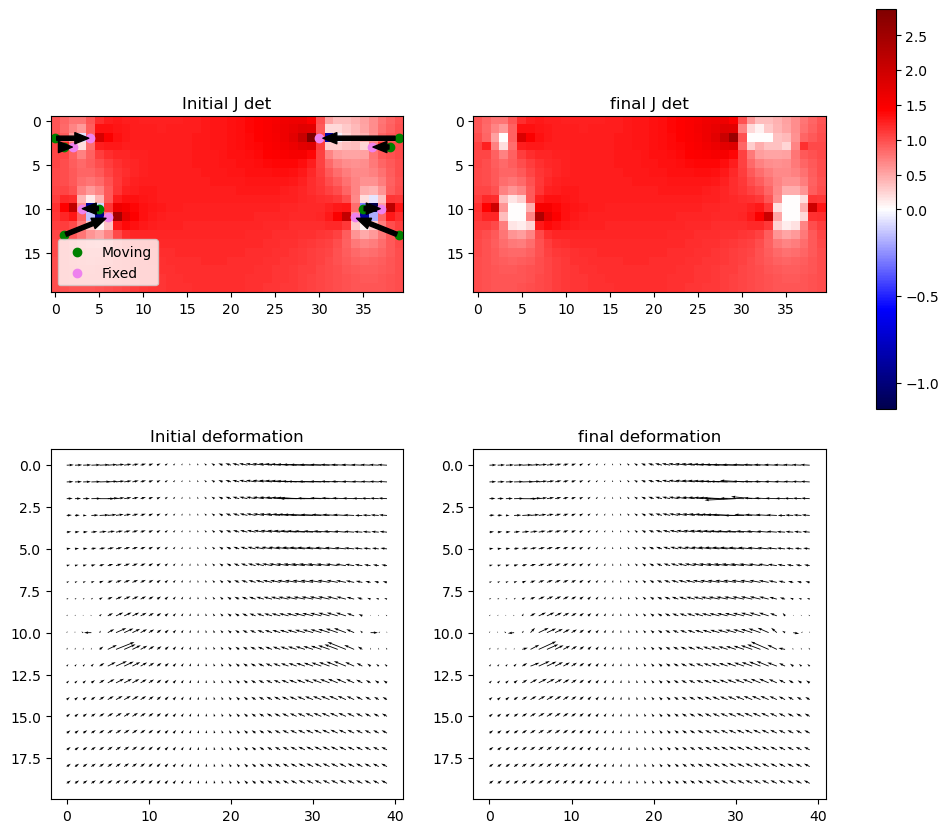

In [8]:
msample = np.array([
    [0, 2, 0],
    [0, 3, 1],
    [0, 10, 5],
    [0, 13, 1],
    [0, 2, 39],
    [0, 3, 38],
    [0, 10, 35],
    [0, 13, 39],
])
fsample = np.array([
    [0, 2, 4],
    [0, 3, 2],
    [0, 10, 3],
    [0, 11, 6],
    [0, 2, 30],
    [0, 3, 36],
    [0, 10, 37],
    [0, 11, 34]
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 16.62014413575945
            Iterations: 180
            Function evaluations: 288231
            Gradient evaluations: 180
OP result error: 16.62014413575945
Deviation from initial = 16.62014413575945
Changed number of -ve jacobians from 158 to 0
Time taken for full SLSQP optimisation: 1078.0031189918518s
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -19.960625  19.961938 -13.570774 -7.200949  0.010000  1.734567
meshgrid shape for plot: (20, 40)


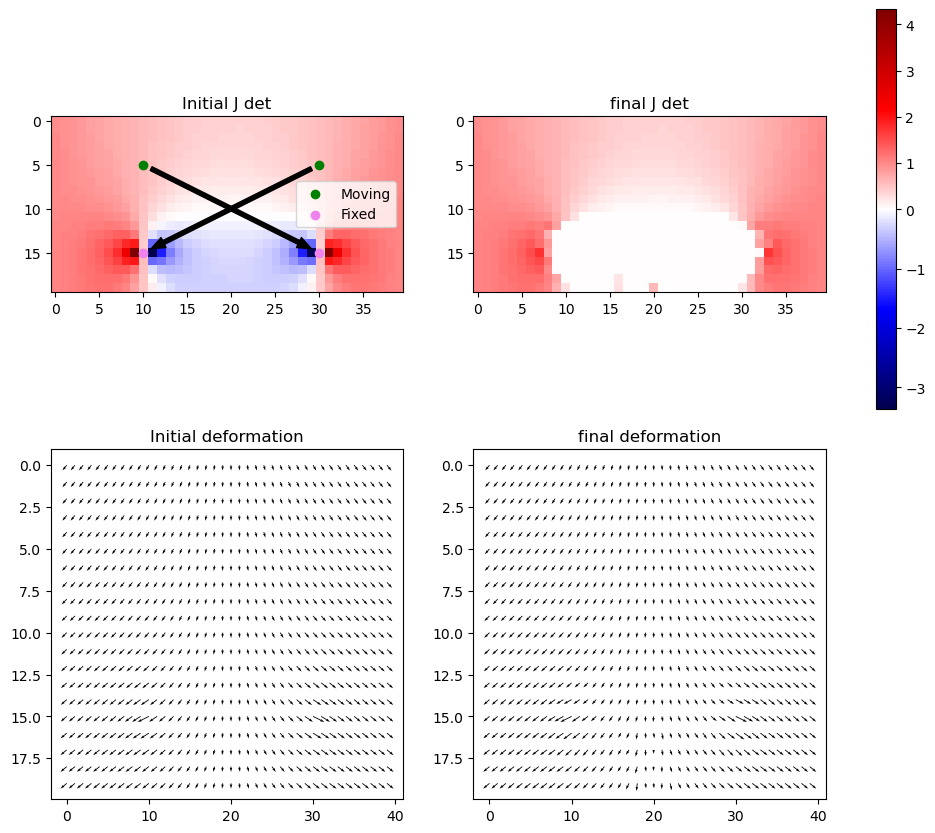

In [9]:
msample = np.array([
    [0, 5, 10],
    [0, 5, 30],
])
fsample = np.array([
    [0, 15, 30],
    [0, 15, 10],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

# 600 iterations
# 83min - final size 9x9

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 4.844880350448548
            Iterations: 46
            Function evaluations: 73670
            Gradient evaluations: 46
OP result error: 4.844880350448548
Deviation from initial = 4.8448803504485465
Changed number of -ve jacobians from 28 to 0
Time taken for full SLSQP optimisation: 296.12344455718994s
             x-def                 y-def             jacobian          
               min        max        min        max       min       max
initial -19.998859 -17.782671 -10.001314  10.001314 -2.028319  3.164794
final   -20.507784 -17.783245  -9.935177   9.939023  0.010000  1.860991
meshgrid shape for plot: (20, 40)


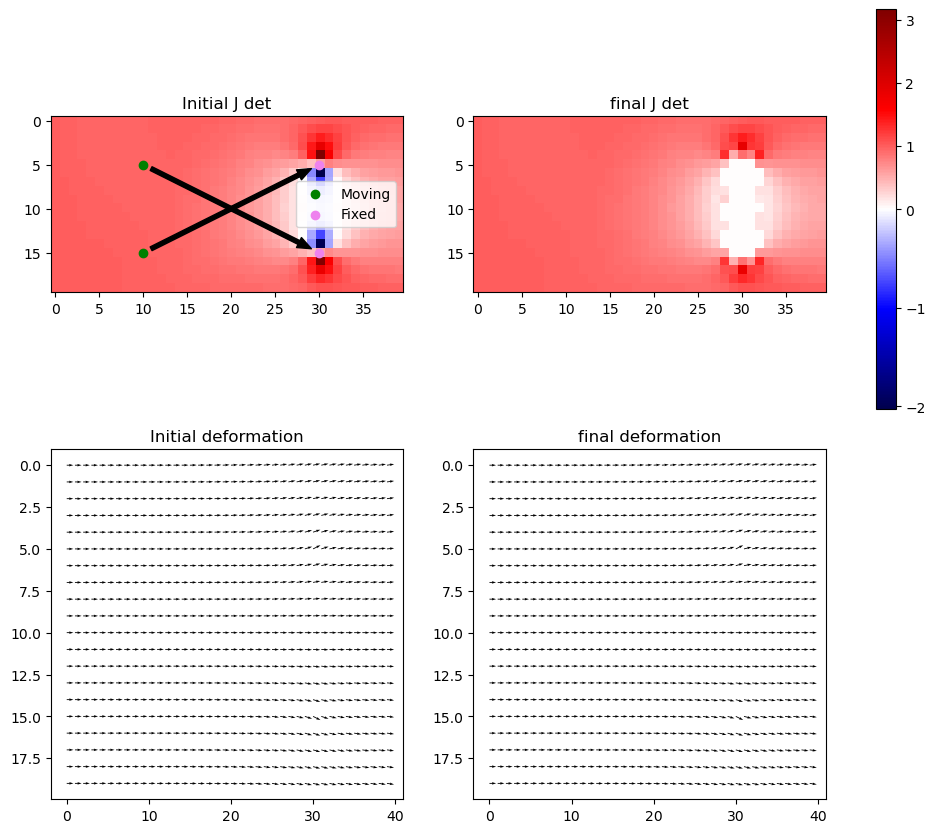

In [10]:
msample = np.array([
    [0, 5, 10],
    [0, 15, 10],
])
fsample = np.array([
    [0, 15, 30],
    [0, 5, 30],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

msample = np.array([
    [0, 5, 10],
    [0, 5, 30],
])
fsample = np.array([
    [0, 15, 30],
    [0, 15, 10],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

# not all iterations take the same time?
# Iter 1 Optimisation for index 611 completed in 0.7802479267120361s
# Iter 635 Optimisation for index 693 completed in 278.3064708709717s
# Iter 573 Optimisation for index 494 completed in 63.11005783081055s
# total time 175m - unfinished

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 2.941606751765476
            Iterations: 17
            Function evaluations: 27230
            Gradient evaluations: 17
OP result error: 2.941606751765476
Deviation from initial = 2.9416067517654794
Changed number of -ve jacobians from 29 to 0
Time taken for full SLSQP optimisation: 107.7691433429718s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -6.999377  4.999555 -4.999602  3.999682 -1.343039  4.142665
final   -7.000041  4.909078 -5.000265  3.845181  0.010000  4.142665
meshgrid shape for plot: (20, 40)


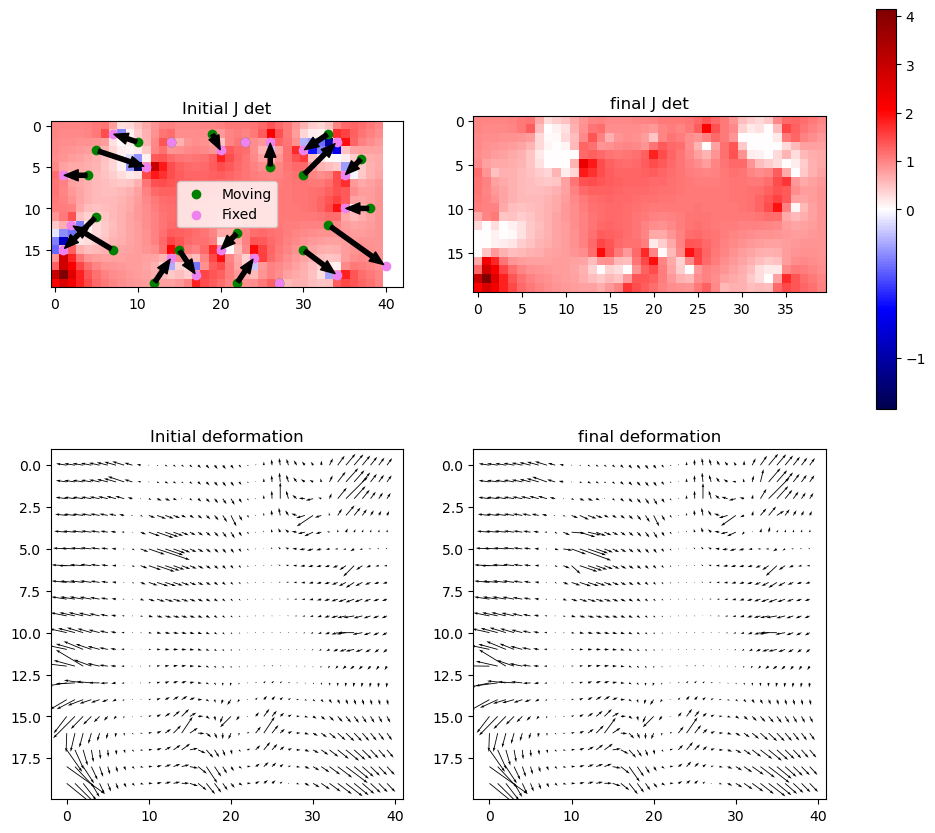

In [11]:
msample = np.array([
    [0, 2, 10],
    [0, 3, 5],
    [0, 6, 4],
    [0, 11, 5],
    [0, 15, 7],
    [0, 19, 12],
    [0, 15, 15],
    [0, 13, 22],
    [0, 19, 22],
    [0, 19, 27],
    [0, 15, 30],
    [0, 12, 33],
    [0, 10, 38],
    [0, 4, 37],
    [0, 6, 30],
    [0, 1, 33],
    [0, 5, 26],
    [0, 2, 23],
    [0, 1, 19],
    [0, 2, 14],
])
fsample = np.array([
    [0, 1, 7],
    [0, 5, 11],
    [0, 6, 1],
    [0, 15, 1],
    [0, 12, 2],
    [0, 16, 14],
    [0, 18, 17],
    [0, 15, 20],
    [0, 16, 24],
    [0, 19, 27],
    [0, 18, 34],
    [0, 17, 40],
    [0, 10, 35],
    [0, 6, 35],
    [0, 2, 34],
    [0, 3, 30],
    [0, 2, 26],
    [0, 2, 23],
    [0, 3, 20],
    [0, 2, 14],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

## Testcases

deformation shape: (3, 1, 5, 6)
deformation_i shape: (3, 1, 5, 6), phi_init shape: (2, 5, 6)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2035144835751
            Iterations: 8
            Function evaluations: 500
            Gradient evaluations: 8
OP result error: 1.2035144835751
Deviation from initial = 1.2035144835750997
Changed number of -ve jacobians from 5 to 0
Time taken for full SLSQP optimisation: 1.6746861934661865s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.999709  2.999709  0.000000  0.000000 -0.728471  1.547029
final   -2.701042  2.598276 -0.400538  0.389625  0.010000  1.365888
meshgrid shape for plot: (5, 6)


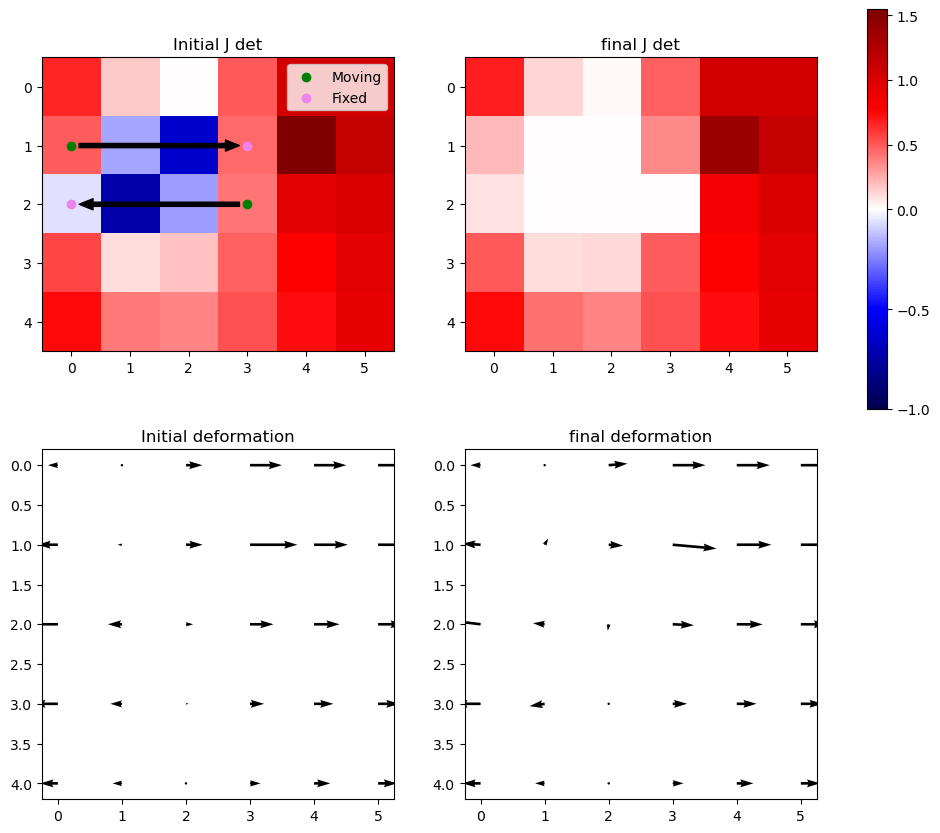

In [12]:
msample = np.array([
    [0, 1, 0],
    [0, 2, 3],
])
fsample = np.array([
    [0, 1, 3],
    [0, 2, 0],
])

fixed_sample = np.zeros((1, 5, 6)) # depth, rows, cols

run_lapl_and_correction(fixed_sample, msample, fsample)

# takes 15 mins and does not conclude on full 20x40 constraints
# 1.5mins on 10x10 constraints
# reduce constraints
# (10,5) - 50 vs 5 - 3.9s vs 0.15s
# (5,5) - 25 vs 5 - 0.35s vs 0.0645s
# (10, 10) - 100 vs 5 - 50s vs 0.46s
# (20, 20) - 400 vs 5 - waited for full one to run for 20min vs 1.5min

# 20x40 with 5 random constraints - 10.5 mins
# 20x40 run over the full thing - 174 min does not finish

deformation shape: (3, 1, 10, 10)
[[[[ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.

C:\Users\Andy\AppData\Local\Temp\ipykernel_43896\7076572.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


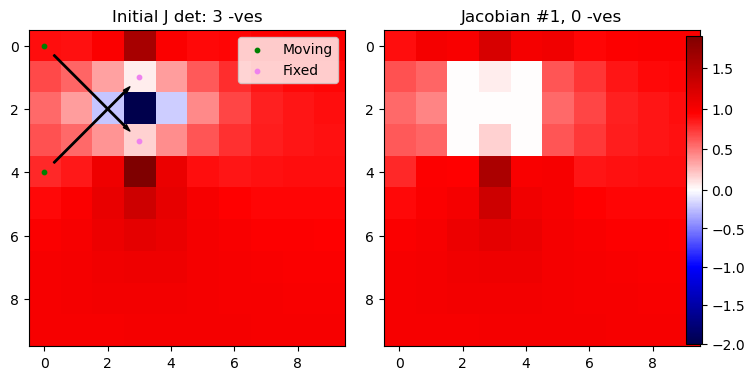

            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -3.013711 -2.977314 -2.999803  2.999803 -2.003395  1.893126
final   -4.006771 -1.996237 -2.886099  2.868033  0.010000  1.564982
meshgrid shape for plot: (10, 10)
[[[ 0.89126076  0.88649201  0.96400756  1.58394211  0.97360102  0.9065901   0.92879864  0.95207293  0.96609706  0.97211199]
  [ 0.67434955  0.56825474  0.34437072  0.07246907  0.36555203  0.62007237  0.77637465  0.86184539  0.90500563  0.9221917 ]
  [ 0.56162551  0.36726659 -0.22374717 -2.0033955  -0.19642219  0.43519678  0.69436959  0.81377889  0.86940417  0.89126523]
  [ 0.64182308  0.56192132  0.39110896  0.17568873  0.42200789  0.62541714  0.75434954  0.82965913  0.86984911  0.88682344]
  [ 0.79774359  0.84437209  1.05607877  1.8931261   1.08067768  0.891393    0.86707284  0.88018585  0.89376049  0.90111237]
  [ 0.90823824  0.96275502  1.09845439  1.31025733  1.11602031  0.99152123

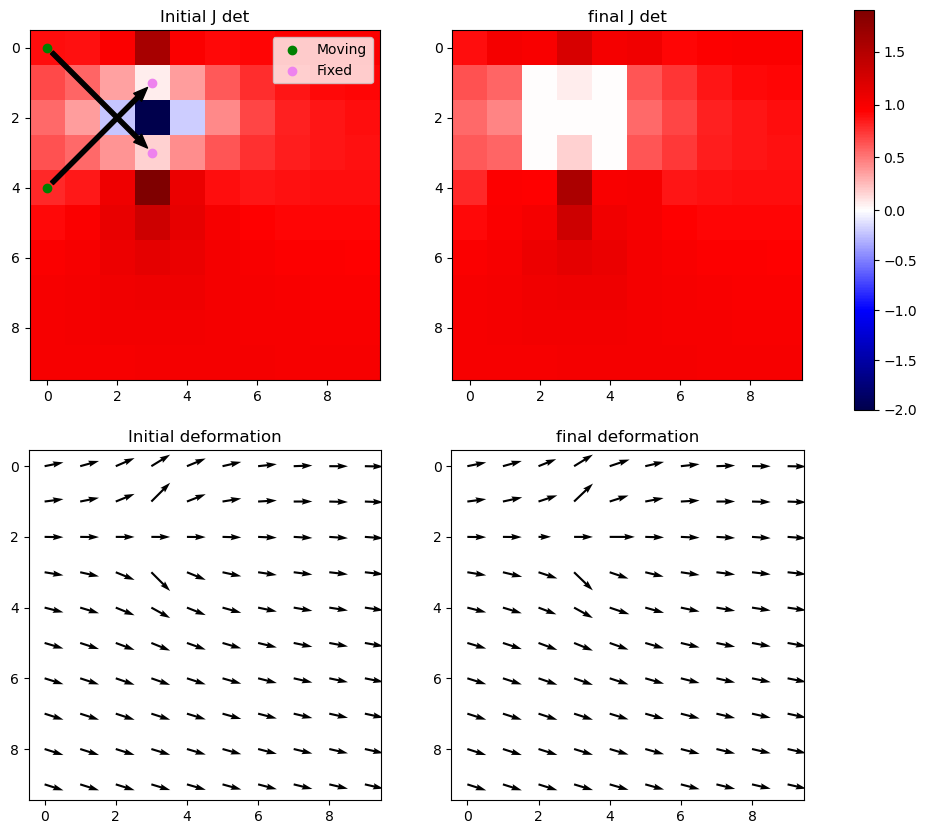

In [13]:
msample = np.array([
    [0, 0, 0],
    [0, 4, 0],
])
fsample = np.array([
    [0, 3, 3],
    [0, 1, 3],
])

fixed_sample = np.zeros((1, 10, 10))
#run_lapl_and_correction(fixed_sample, msample, fsample)
deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, msample, fsample)
print(f'deformation shape: {deformation_i.shape}')
print(deformation_i)
phi_corrected, jacobians = full_slsqp(deformation_i, methodName='SLSQP')
plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
print(jacobian_det2D(deformation_i[1:]))

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.6256445892157437
            Iterations: 11
            Function evaluations: 2225
            Gradient evaluations: 11
OP result error: 0.6256445892157437
Deviation from initial = 0.6256445892157437
Changed number of -ve jacobians from 2 to 0
Time taken for full SLSQP optimisation: 6.98206639289856s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial  0.000000  0.000000 -2.999713  2.999713 -0.356906  1.700982
final   -0.069483  0.067177 -2.756832  2.642664  0.010000  1.571442
meshgrid shape for plot: (10, 10)


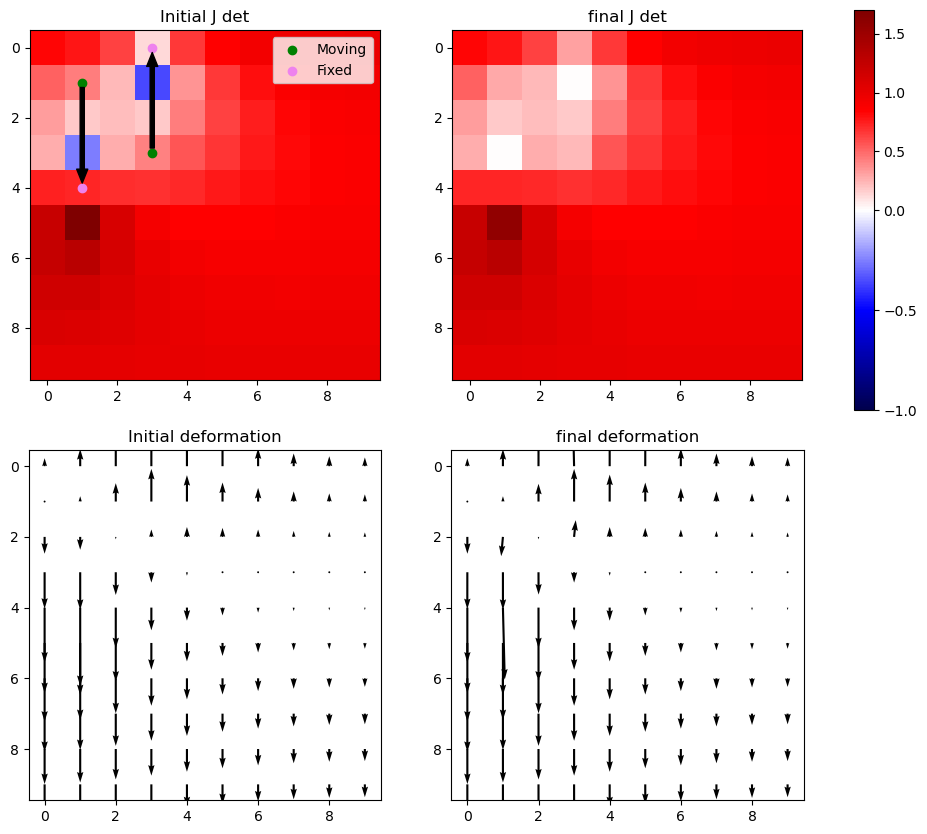

In [14]:
msample = np.array([
    [0, 1, 1],
    [0, 3, 3],
])
fsample = np.array([
    [0, 4, 1],
    [0, 0, 3],
])

fixed_sample = np.zeros((1, 10, 10))
#test_grad(fixed_sample, msample, fsample)
#test_scipy(fixed_sample, msample, fsample)
run_lapl_and_correction(fixed_sample, msample, fsample)

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.0022055039162810542
            Iterations: 9
            Function evaluations: 1827
            Gradient evaluations: 9
OP result error: 0.0022055039162810542
Deviation from initial = 0.0022055039162810542
Changed number of -ve jacobians from 0 to 0
Time taken for full SLSQP optimisation: 5.893942832946777s
            x-def              y-def            jacobian          
              min      max       min       max       min       max
initial -3.999719 -0.99993  0.000000  0.000000  0.008381  1.445456
final   -3.998216 -0.99993 -0.000413  0.000413  0.010000  1.444683
meshgrid shape for plot: (10, 10)


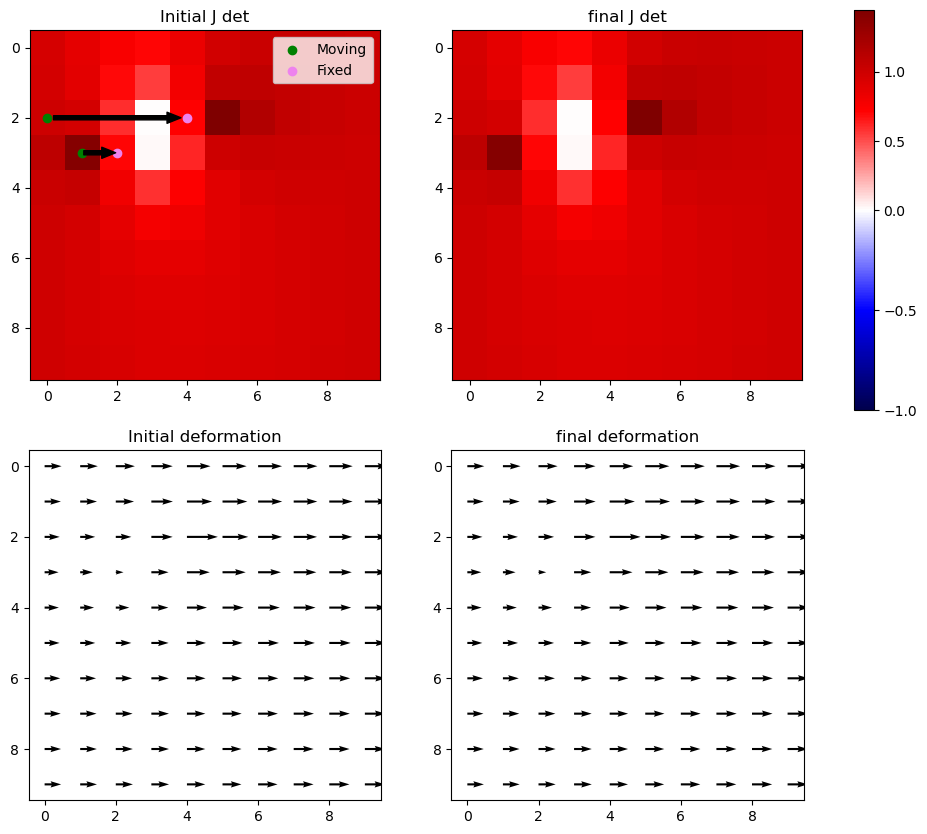

In [15]:
msample = np.array([
    [0, 2, 0],
    [0, 3, 1],
])
fsample = np.array([
    [0, 2, 4],
    [0, 3, 2],
])

fixed_sample = np.zeros((1, 10, 10))
#test_grad(fixed_sample, msample, fsample)
#test_scipy(fixed_sample, msample, fsample)
#red_test_scipy(fixed_sample, msample, fsample)
run_lapl_and_correction(fixed_sample, msample, fsample)

(15, 3) (15, 3)
deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 14.414829507789696
            Iterations: 74
            Function evaluations: 118477
            Gradient evaluations: 74
OP result error: 14.414829507789696
Deviation from initial = 14.414829507789696
Changed number of -ve jacobians from 129 to 0
Time taken for full SLSQP optimisation: 457.6041843891144s
             x-def                y-def            jacobian          
               min        max       min       max       min       max
initial -13.002136  29.004766  0.000000  1.000051 -5.157539  8.077514
final   -13.011934  28.971139 -2.374702  2.707648  0.010000  4.625691
meshgrid shape for plot: (20, 40)


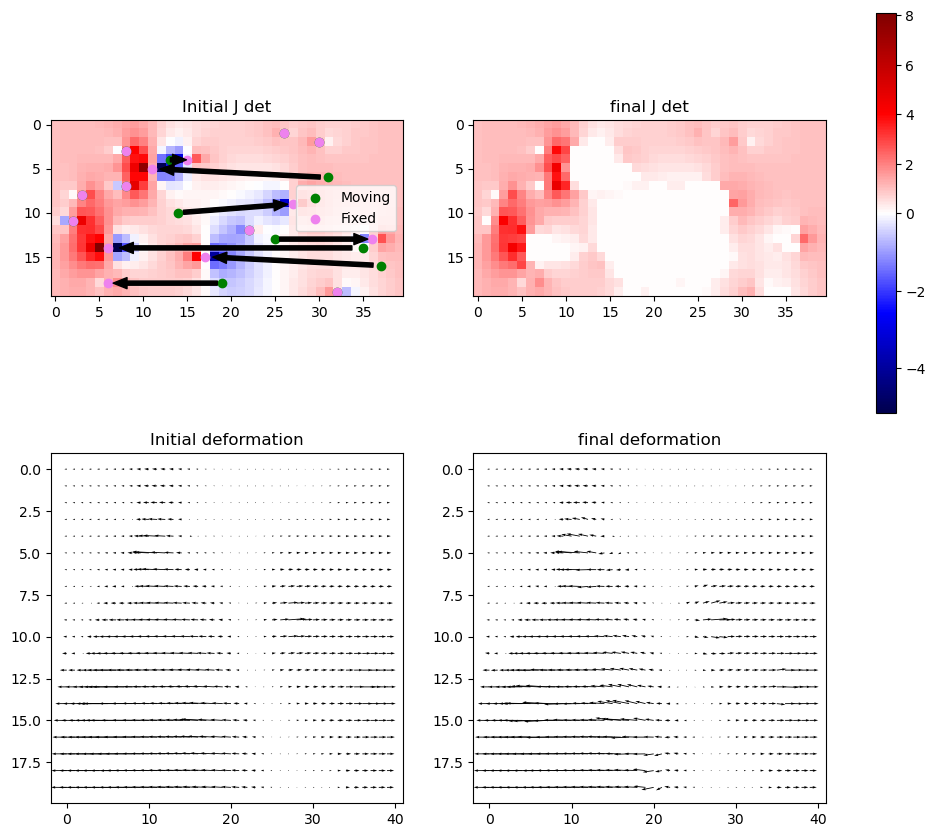

In [16]:
# data analysis

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

mpoints, fpoints = correspondences.downsample_points(mpoints_path, fpoints_path, debug=False)
#print(mpoints.shape, fpoints.shape) 

fixed_sample = np.zeros((1, 20, 40))

# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 1

# use 
mask = mpoints[:,0]==slice_no
new_mpoints = mpoints[mask].copy()
new_mpoints[:,0] = 0

mask = fpoints[:,0]==slice_no
new_fpoints = fpoints[mask].copy()
new_fpoints[:,0] = 0

print(new_mpoints.shape, new_fpoints.shape)


#test_grad(fixed_sample, msample, fsample)
#red_test_scipy(fixed_sample, new_mpoints[:5], new_fpoints[:5])
run_lapl_and_correction(fixed_sample, new_mpoints, new_fpoints)

## Real slice

In [17]:
# # data analysis

# # Create sample set of points
# mpoints_path = "../data/corrected_correspondences_count_touching/mpoints.npy"
# fpoints_path = "../data/corrected_correspondences_count_touching/fpoints.npy"

# mpoints, fpoints = correspondences.downsample_points(mpoints_path, fpoints_path, debug=False)
# #print(mpoints.shape, fpoints.shape) 

# deformation_field_path = "../data/base_unique_correspondences/registered_output/deformation3d.npy"
# deformation_field = np.load(deformation_field_path)

# # select a slice
# def_shape = deformation_field.shape
# print(def_shape)
# deformation_i = deformation_field[:, 349].reshape((def_shape[0], 1, def_shape[2], def_shape[3]))
# print(deformation_i.shape)
# # z values in mpoints, fpoints are for 3 slices numbered 0,1,2
# slice_no = 0

# # use 
# mask = mpoints[:,0]==slice_no
# new_mpoints = mpoints[mask].copy()
# new_mpoints[:,0] = 0

# mask = fpoints[:,0]==slice_no
# new_fpoints = fpoints[mask].copy()
# new_fpoints[:,0] = 0

# print(new_mpoints.shape, new_fpoints.shape)

# phi_corrected, jacobians = iterative_with_jacobians(deformation_i)
# plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
# plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
# # kept running for 450min

## Jdet function testing

In [18]:
# global val list
print(list_dev)
print('===')
print(num_neg_jac)
print('=====')
print(time_taken)

# L2
list_dev_L2 = [2.680895253076589, 69.80633869969029, 9.418067274643581, 69.80633869969029, 5.197075330527052, 1.8231005476373714, 2.2589086079637837, 2.8612431766103588, 0.0, 27.945036523729176]

num_neg_jac_init_L2 = [12, 158, 28, 158, 29, 5, 3, 2, 0, 129]

num_neg_jac_L2 = [0, 132, 15, 132, 0, 0, 0, 0, 0, 115]

# L2s
list_dev_L2s = [4.768607942055218, 26.252278493509536, 10026.7948106916, 26.252278493509536, 9.104921565888146, 2.379737612461383, 3.019209538644817, 3.1687868005130904, 0.0, 25.14703328621248]

num_neg_jac_L2s = [0, 137, 15, 137, 0, 0, 0, 0, 0, 109]

# L1

list_dev_L1 = [3.1452826411439276, 49.78213374285741, 12.373348412316172, 49.78213374285741, 12.224721045040889, 2.2478387386726184, 2.419587408528433, 3.1974909624498786, 0.0, 22.553299646732658]

num_neg_jac_L1 = [0, 135, 7, 135, 2, 0, 0, 0, 0, 106]

# L1s
list_dev_L1s = [3.8200316274887136, 27.98726389799386, 11.400909181236925, 27.98726389799386, 7.421816327869949, 2.3274873804728444, 2.952056050877296, 3.112671741644684, 0.0, 21.352944007229933]

num_neg_jac_L1s = [0, 132, 11, 132, 0, 0, 0, 0, 0, 110]

#L2wr
list_dev_L2wr = [1.3388562022484387e-06, 2.1911745978666906, 0.5583311141489217, 2.1911745978666906, 0.00010905921377629281, 8.880030350916757e-08, 8.065887478278329e-07, 8.93188013674346e-08, 0.0, 1.4515563532878142]

num_neg_jac_L2wr = [12, 156, 27, 156, 29, 5, 3, 2, 0, 125]

#L1wr - this
list_dev_L1wr = [1.8719204800182033e-05, 2.800815958456984, 0.6335240860765275, 2.800815958456984, 0.01548376720517454, 3.821057987703311e-05, 2.2714245365299625e-05, 3.223513937255436e-05, 0.0, 2.2229220010626967]

num_neg_jac_L1wr = [12, 156, 29, 156, 29, 5, 3, 2, 0, 123]

#L2swr
list_dev_L2swr = [6.347496024011014, 6.0603622126465195, 8.073554663868867, 6.0603622126465195, 9.805082662138908, 2.4315062468207964, 3.329061274139249, 1.7311478095318673, 0.0, 19.893147478504304]

num_neg_jac_L2swr = [0, 162, 30, 162, 6, 0, 0, 0, 0, 127]
tt_L2swr = [[1.0550048351287842, 15.897326946258545, 5.623910903930664, 16.062530040740967, 12.120941877365112, 0.3773469924926758, 0.3408081531524658, 0.3339860439300537, 0.15784001350402832, 8.772908926010132]
]
ttt_L2swr = 71.68918776512146

#L1swr
list_dev_L1swr = [3.300356140988371, 5.219200883030088, 3.8569020877225846, 5.219200883030088, 4.37866602840255, 1.4021137590566208, 2.0081703705493297, 1.228014013747989, 0.0, 11.192059918711248]

num_neg_jac_L1swr = [11, 156, 28, 156, 19, 4, 3, 0, 0, 121]
tt_L1swr = [38.703429222106934, 85.19641089439392, 57.048078775405884, 85.34915089607239, 37.369688749313354, 21.995036840438843, 18.338409185409546, 3.49845290184021, 0.16025185585021973, 81.12396311759949]

ttt_L1swr = 437.7158851623535

full_end = time.time()
print("time taken is", full_end-full_start)

[2.0253272720089566, 16.62014413575945, 4.8448803504485465, 2.9416067517654794, 1.2035144835750997, 1.5814964717879532, 0.6256445892157437, 0.0022055039162810542, 14.414829507789696]
===
[0, 0, 0, 0, 0, 0, 0, 0, 0]
=====
[72.85828137397766, 1078.0031189918518, 296.12344455718994, 107.7691433429718, 1.6746861934661865, 5.418190956115723, 6.98206639289856, 5.893942832946777, 457.6041843891144]
time taken is 2038.6277694702148


# Now try with full slice

### Downsampled 0.2

deformation shape: (3, 1, 64, 91)
deformation_i shape: (3, 1, 64, 91), phi_init shape: (2, 64, 91)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.5756964375847223
            Iterations: 16
            Function evaluations: 186397
            Gradient evaluations: 16
OP result error: 0.5756964375847223
Deviation from initial = 0.5756964375847213
Changed number of -ve jacobians from 3 to 0
Time taken for full SLSQP optimisation: 18471.36737179756s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.999731  1.999820 -1.999811  1.999811 -0.466025  2.764354
final   -2.709091  1.999818 -1.999813  1.999809  0.009999  2.764354
meshgrid shape for plot: (64, 91)
Time taken for full optimisation on downsized 20% full idx 350 slice: 18471.612410068512 seconds


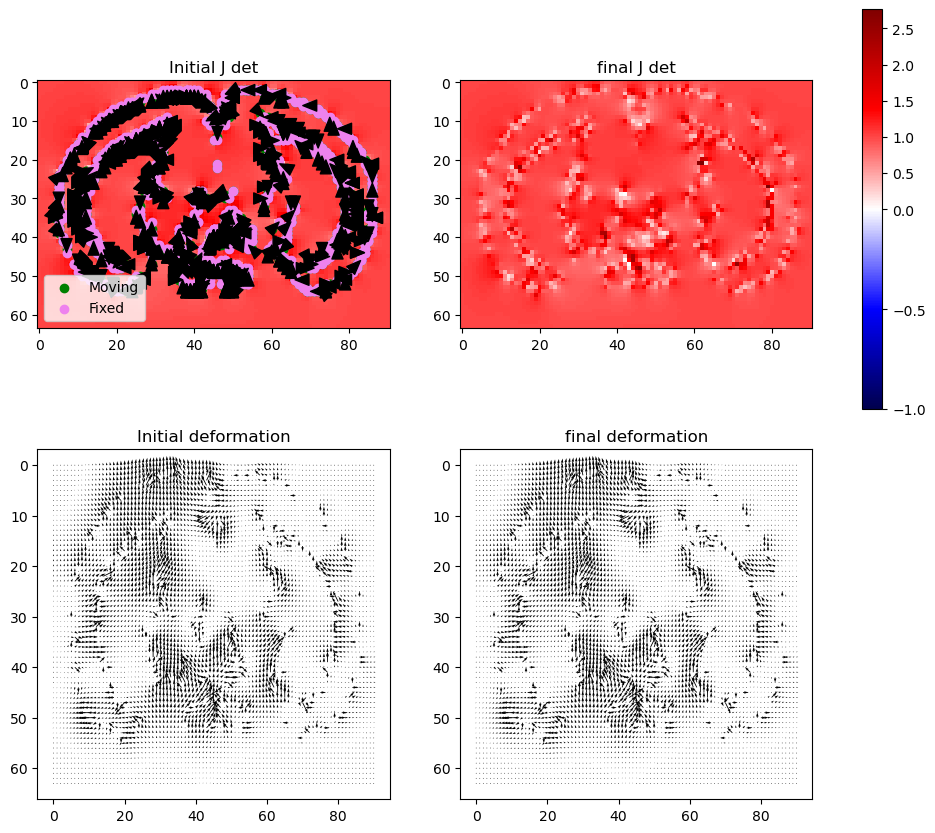

In [14]:
start = time.time()

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

msample = np.load(mpoints_path)
fsample = np.load(fpoints_path)
fixed_sample = np.zeros((1, 320, 456))

# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 350

# use 
mask = msample[:,0]==slice_no
new_mpoints = msample[mask].copy()
new_mpoints[:, 0] = 0

mask = fsample[:,0]==slice_no
new_fpoints = fsample[mask].copy()
new_fpoints[:,0] = 0

#deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, new_mpoints, new_fpoints)
#print(f'deformation shape: {deformation_i.shape}')
#print(deformation_i.dtype)


# Shrink the samples to a smaller resolution for faster processing
scale_factor = 0.2
# Multiply every coordinate by 0.75 and make sure to round them
new_mpoints[:, :] = np.round(new_mpoints[:, :] * scale_factor).astype(int)
new_fpoints[:, :] = np.round(new_fpoints[:, :] * scale_factor).astype(int)

# Create a fixed sample with smaller resolution
fixed_sample = np.zeros((1, int(320 * scale_factor), int(456 * scale_factor)))  # Adjusted size for smaller resolution


phi_corrected, jacobians = run_lapl_and_correction(fixed_sample, new_mpoints, new_fpoints)
elapsed = time.time() - start
print(f"Time taken for full optimisation on downsized 20% full idx 350 slice: {elapsed} seconds")
np.save("output/phi_corrected.npy", phi_corrected)
np.save("output/jacobians.npy", jacobians)

### Full res

In [ ]:
start = time.time()

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

msample = np.load(mpoints_path)
fsample = np.load(fpoints_path)
fixed_sample = np.zeros((1, 320, 456))

# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 350

# use 
mask = msample[:,0]==slice_no
new_mpoints = msample[mask].copy()
new_mpoints[:, 0] = 0

mask = fsample[:,0]==slice_no
new_fpoints = fsample[mask].copy()
new_fpoints[:,0] = 0

#deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, new_mpoints, new_fpoints)
#print(f'deformation shape: {deformation_i.shape}')
#print(deformation_i.dtype)

phi_corrected, jacobians = run_lapl_and_correction(fixed_sample, new_mpoints, new_fpoints)
elapsed = time.time() - start
print(f"Time taken for full optimisation on full idx 350 slice: {elapsed} seconds")

# Upscale, measure time

In [8]:
def plot_deformation(msample, fsample, deformation, title="", figsize=(20, 10), show_values=True, show_points=True):
    """
    Plots the deformation field between two sets of points.
    """
    
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=figsize)
    
    # Calculate the Jacobian determinant
    J = np.squeeze(jacobian.sitk_jacobian_determinant(deformation))
    num_neg_J = np.sum(J <= 0)
    norm = mcolors.TwoSlopeNorm(vmin=min(J.min(), J.min(), -3), vcenter=0, vmax=max(J.max(), J.max(), 3))

    # Draw lines connecting the points in the first subplot
    for i in range(len(msample)):  # Draw lines connecting the points
        axs[0].annotate(
            '', 
            xy=(fsample[i][2], fsample[i][1]), 
            xytext=(msample[i][2], msample[i][1]), 
            arrowprops=dict(facecolor='black', shrink=0.045, headwidth=8, headlength=10, width=3)
        )
    
    # Create a grid of points
    x, y = np.meshgrid(range(deformation.shape[3]), range(deformation.shape[2]), indexing='xy')

    # Plot the initial points and Jacobian determinant scores
    im = axs[0].imshow(J, cmap='seismic', norm=norm)
    axs[0].set_title(f"Jacobian determinant grid\n({num_neg_J} negative Jacobian values)")
    
    axs[0].set_xticks(np.arange(0, deformation.shape[3], 1))
    axs[0].set_yticks(np.arange(0, deformation.shape[2], 1))

    if show_values:
        # Add text for the values
        for i in range(J.shape[0]):
            for j in range(J.shape[1]):
                axs[0].text(j, i, f"{J[i, j]:.2f}", ha="center", va="center", color="black", fontsize=8)
        
        for i in range(J.shape[0]):
            for j in range(J.shape[1]):
                axs[1].text(j, i + 0.3, f"{J[i, j]:.2f}", ha="center", va="center", color="black", fontsize=8)

    # Plot the deformation vectors
    axs[1].set_title(f"Deformation vector field")
    axs[1].imshow(J, cmap='seismic', norm=norm)
    axs[1].quiver(x, y, deformation[2,0], deformation[1,0])
    
    axs[1].set_xticks(np.arange(0, deformation.shape[3], 1))
    axs[1].set_yticks(np.arange(0, deformation.shape[2], 1))
    
    if show_points:
        axs[0].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving')
        axs[0].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed')
        axs[0].legend()
        axs[1].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving')
        axs[1].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed')
        axs[1].legend()
    
    # Add colorbar
    #cbar_ax = fig.add_axes([0.94, 0.15, 0.015, 0.7])
    #cbar = fig.colorbar(im, cax=cbar_ax)
    #cbar.set_label('Jacobian determinant')
    
    # Draw very light grid lines between moving and fixed points
    for i in range(len(msample)):
        axs[1].plot(
            [msample[i][2], fsample[i][2]],
            [msample[i][1], fsample[i][1]],
            color='gray',
            linestyle='--',
            linewidth=1,
            alpha=0.5,
            zorder=1
        )
    
    # Invert y-axes
    axs[0].invert_yaxis()
    axs[1].invert_yaxis()
    
    # Set titles
    fig.suptitle(title, fontsize=16)
    
    # Add colorbar that matches the height of the axes
    divider = make_axes_locatable(axs[1])
    cax = divider.append_axes("right", size="5%", pad=0.15)
    cbar = fig.colorbar(im, cax=cax)
    cbar.set_label('Jacobian determinant')
    
    plt.tight_layout()
    plt.show()

## Upscale DVF and count time

In [9]:
import numpy as np
from scipy.ndimage import zoom


def generate_random_dvf(shape, max_magnitude=5.0, seed=None):
    """
    Generate a random 2D deformation vector field (DVF).
    
    Parameters:
        shape: tuple (3, 1, H, W)
        max_magnitude: float, max displacement in pixels
        seed: int or None, for reproducibility

    Returns:
        np.ndarray of shape (3, 1, H, W)
    """
    if seed is not None:
        np.random.seed(seed)

    C, _, H, W = shape
    assert C == 3, "DVF must have 3 channels (dz, dy, dx)"
    
    # Uniform random displacement in range [-max_magnitude, +max_magnitude]
    dvf = np.random.uniform(-max_magnitude, max_magnitude, size=shape).astype(np.float32)
    return dvf


def scale_dvf_numpy(dvf, new_size):
    """
    Downscale a deformation vector field (DVF).
    dvf: np.ndarray of shape (3, 1, H, W)
    new_size: (new_H, new_W)
    """
    C, _, H, W = dvf.shape
    new_H, new_W = new_size
    scale_y = new_H / H
    scale_x = new_W / W

    dvf_resized = np.zeros((C, 1, new_H, new_W), dtype=dvf.dtype)
    for c in range(C):
        # zoom along spatial dimensions
        dvf_resized[c, 0] = zoom(dvf[c, 0], (scale_y, scale_x), order=1)

    # scale vector magnitudes appropriately
    dvf_resized[2, 0] *= scale_x  # x
    dvf_resized[1, 0] *= scale_y  # y
    #dvf_resized[2, 0] *= (scale_x + scale_y) / 2  # z, if needed

    return dvf_resized

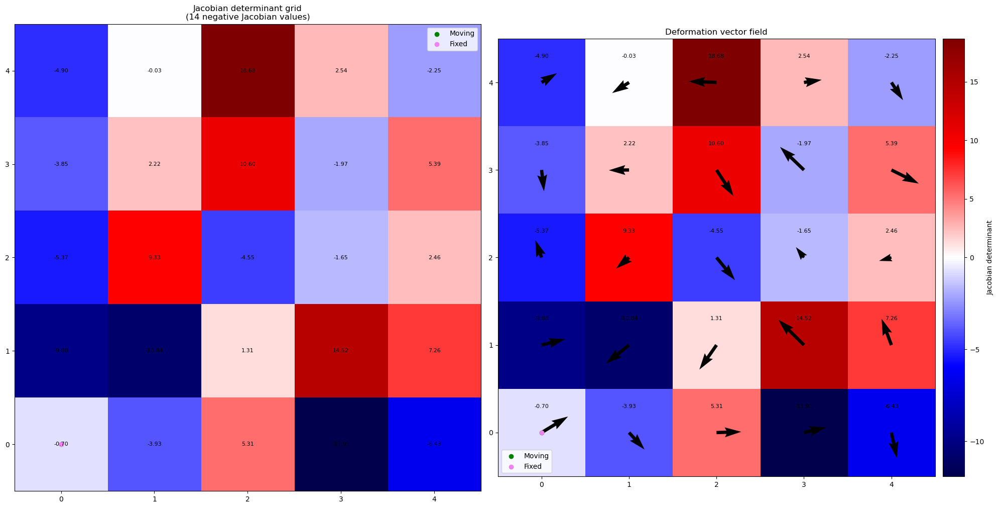

Scaled DVF shape: (3, 1, 7, 7)


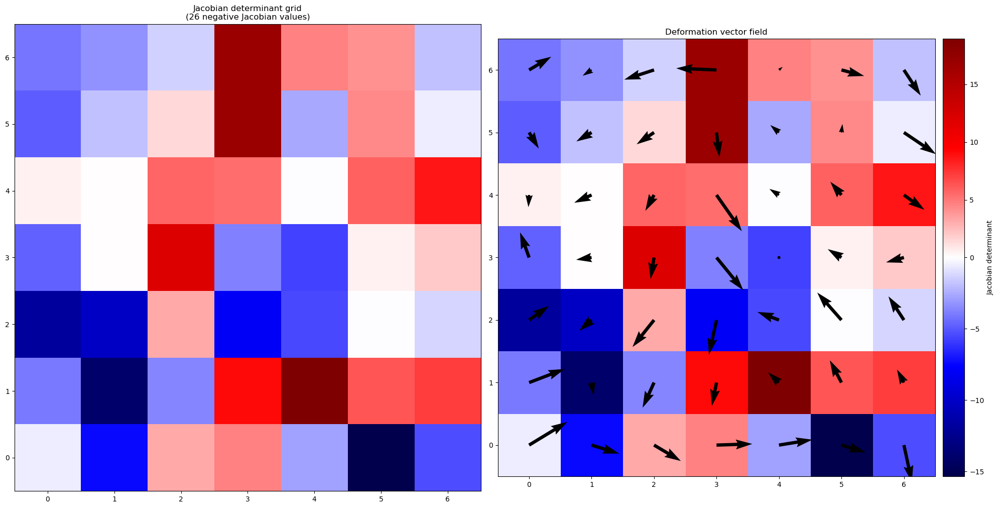

Scaled DVF shape: (3, 1, 9, 9)


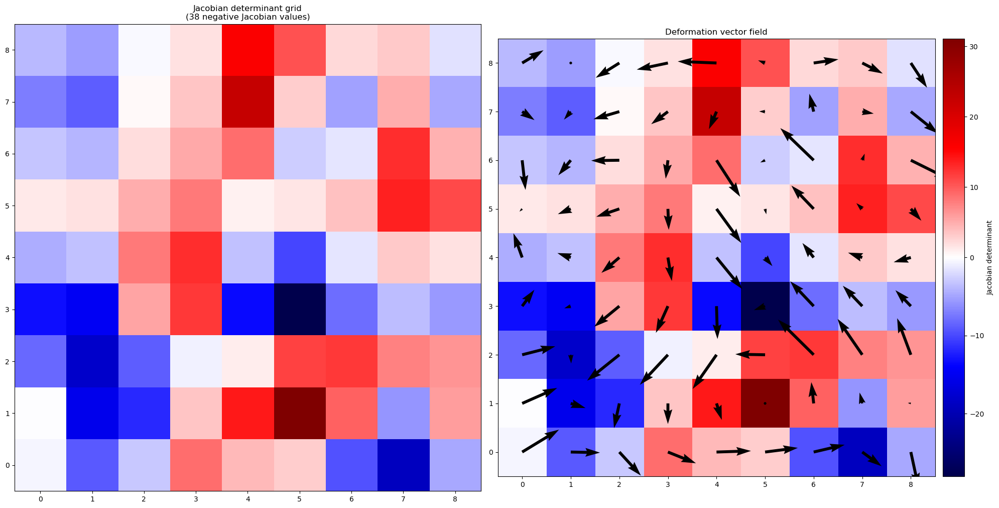

Scaled DVF shape: (3, 1, 11, 11)


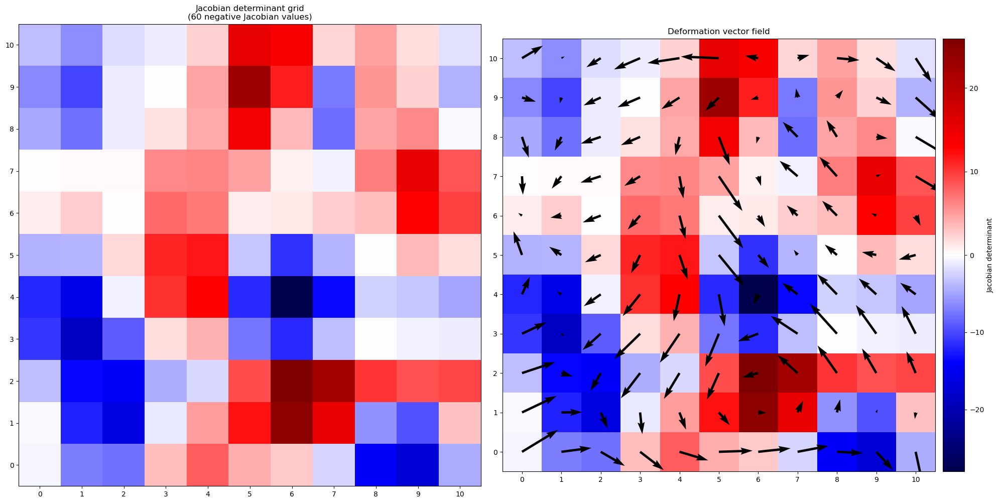

Scaled DVF shape: (3, 1, 13, 13)


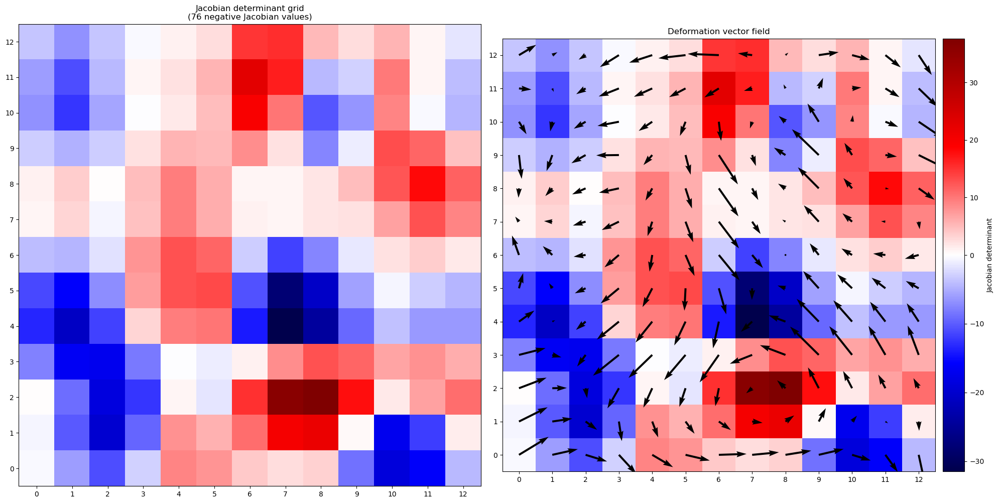

Scaled DVF shape: (3, 1, 15, 15)


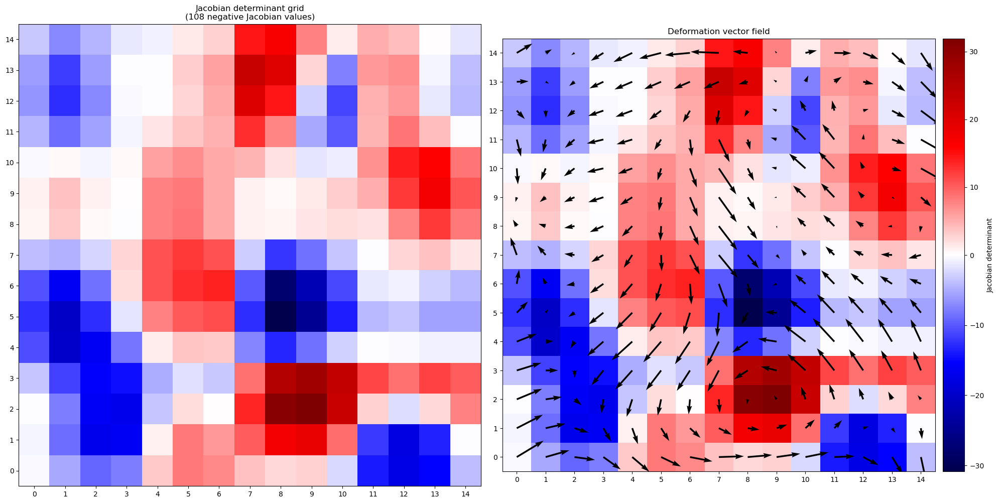

Scaled DVF shape: (3, 1, 17, 17)


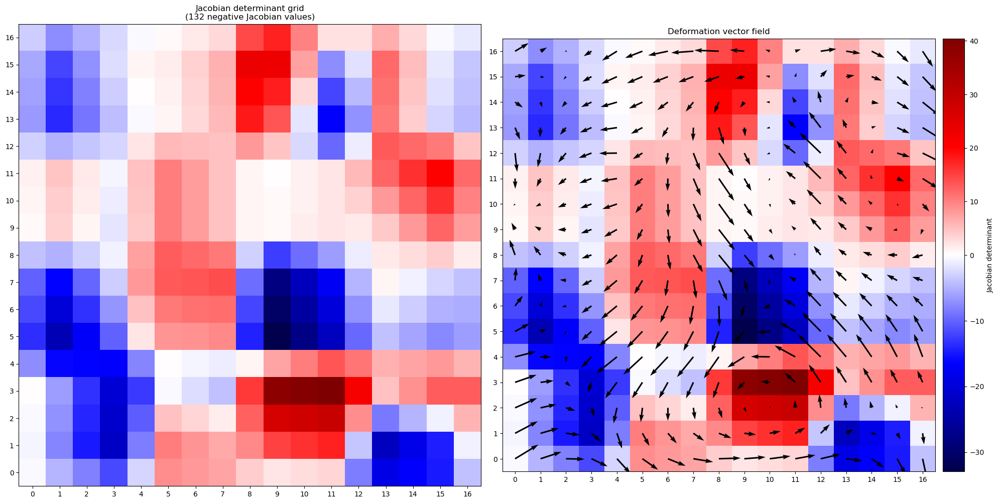

Scaled DVF shape: (3, 1, 19, 19)


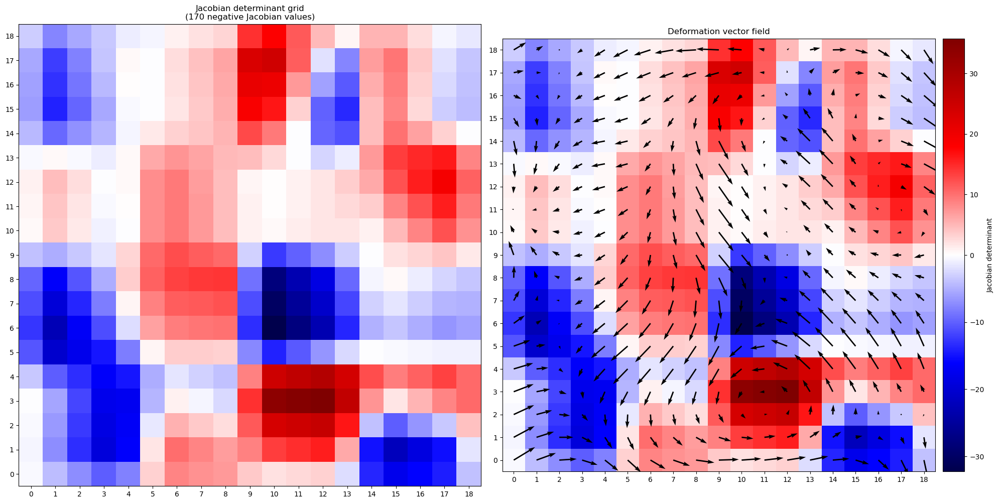

Scaled DVF shape: (3, 1, 21, 21)


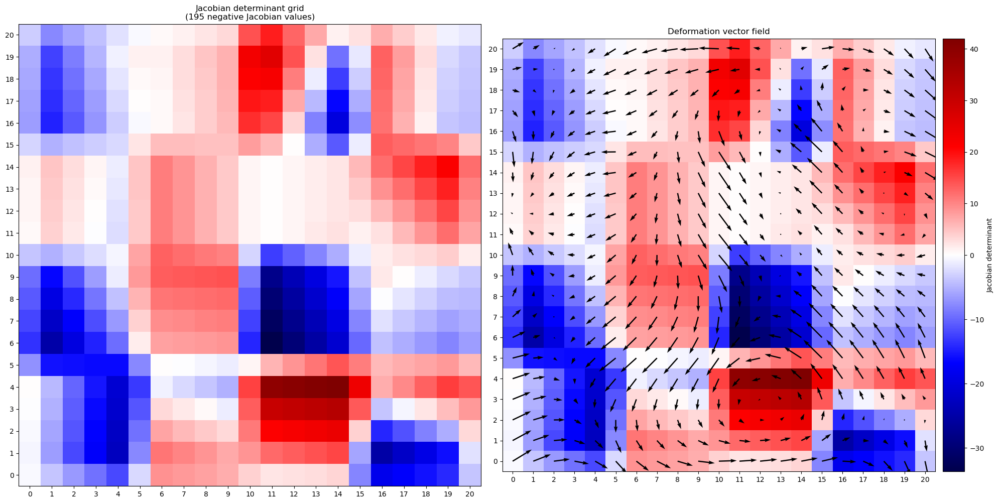

Scaled DVF shape: (3, 1, 23, 23)


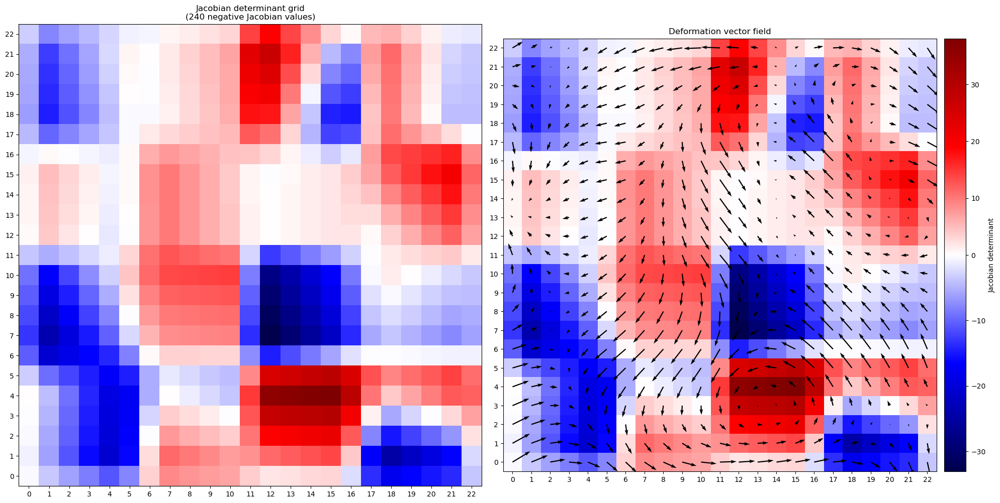

Scaled DVF shape: (3, 1, 25, 25)


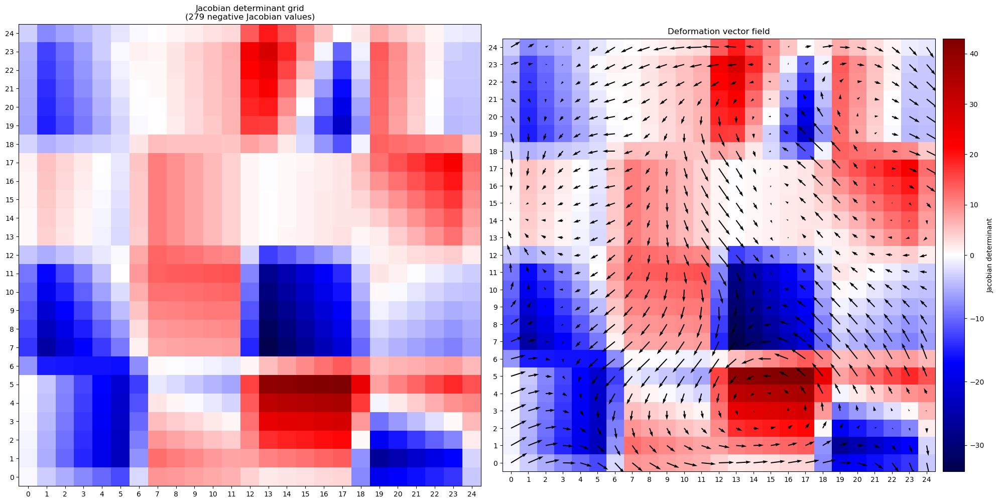

Scaled DVF shape: (3, 1, 27, 27)


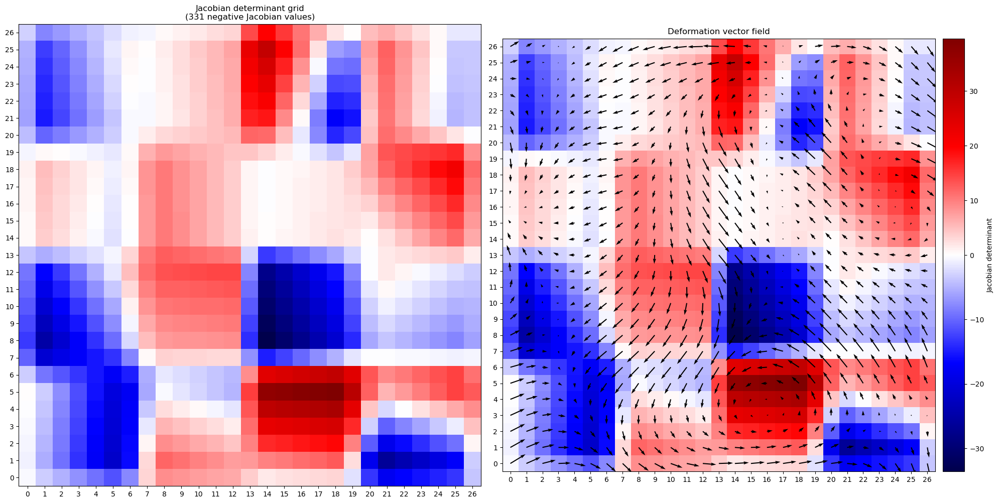

Scaled DVF shape: (3, 1, 29, 29)


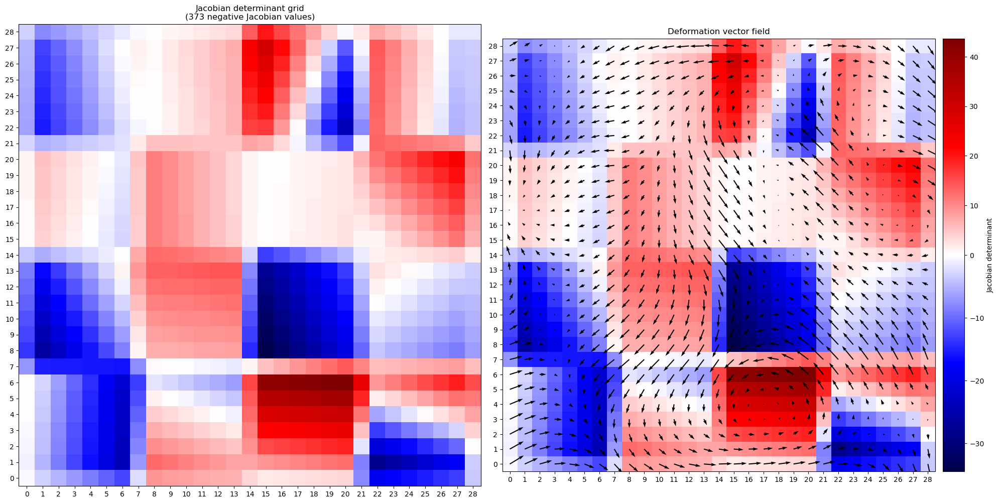

In [50]:
# Start with an initial DVF
original_shape = (3, 1, 5, 5)
dvf_sizes = [s for s in range(5, 31, 2)]  # Add sizes from 5 to 20 in steps of 2

# Generate initial random DVF
dvf = generate_random_dvf(original_shape, max_magnitude=5.0, seed=42)
plot_deformation(
    msample=np.array([[0, 0, 0]]),
    fsample=np.array([[0, 0, 0]]),
    deformation=dvf)
dvf_list = [dvf]


# Now make a sequence of upscaled DVFs
for i in range(len(dvf_sizes)):
    size = dvf_sizes[i]
    if i == 0:
        continue
    new_size = (size, size)
    dvf_temp = scale_dvf_numpy(dvf, new_size=new_size)
    dvf_list.append(dvf_temp)
    print(f"Scaled DVF shape: {dvf_temp.shape}")
    plot_deformation(
        msample=np.array([[0, 0, 0]]),
        fsample=np.array([[0, 0, 0]]),
        deformation=dvf_temp,
        show_points= False, show_values=False)

In [ ]:
time_counts = []  # Keep track of time for each scale factor
num_repeats = 3  # Number of times to run the correction for each DVF
for i in range(len(dvf_sizes)):
    curr_size = dvf_sizes[i]
    curr_dvf = dvf_list[i]
    print(f"Processing DVF of size {curr_size}x{curr_size}")
    #for i in range(10):
    #curr_elapsed = [] # Reset for each scale factor
    
    # Run the Laplacian and correction
    all_elapsed = []
    for j in range(num_repeats):
        start = time.time()
        phi_corrected, jacobians = run_correction_only(np.array([[0, 0, 0]]), np.array([[0, 0, 0]]), curr_dvf)
        elapsed = time.time() - start
        print(f"Time taken for optimization on {curr_size}x{curr_size}: {elapsed} seconds\n\n")
        all_elapsed.append(elapsed)
    time_counts.append(np.mean(all_elapsed))
    #time_counts.append(np.mean(curr_elapsed))  # Store the average time for this scale factor

Processing DVF of size 5x5
deformation_i shape: (3, 1, 5, 5), phi_init shape: (2, 5, 5)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 8.826681464148384
            Iterations: 43
            Function evaluations: 2200
            Gradient evaluations: 43
OP result error: 8.826681464148384
Deviation from initial = 8.826681464148384
Changed number of -ve jacobians from 14 to 0
Time taken for full SLSQP optimisation: 6.723047733306885s
            x-def               y-def             jacobian           
              min       max       min       max        min        max
initial -4.944779  4.868869 -4.656115  4.656320 -11.905626  18.681094
final   -4.906412  4.428303 -5.161018  5.124305   0.010000  12.645389
meshgrid shape for plot: (5, 5)
Time taken for optimization on 5x5: 6.751578330993652 seconds


deformation_i shape: (3, 1, 5, 5), phi_init shape: (2, 5, 5)
Optimization terminated successfully    (Exit mode 0)
            Current function

C:\Users\Andy\AppData\Local\Temp\ipykernel_32728\2651218989.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(nrows=2, ncols=2, figsize=figsize)


Optimization terminated successfully    (Exit mode 0)
            Current function value: 56.10078495884302
            Iterations: 137
            Function evaluations: 99060
            Gradient evaluations: 137
OP result error: 56.10078495884302
Deviation from initial = 56.10078495884302
Changed number of -ve jacobians from 170 to 0
Time taken for full SLSQP optimisation: 275.258677482605s
             x-def                 y-def              jacobian           
               min        max        min        max        min        max
initial -18.790159  17.844215 -17.426039  15.888573 -32.258515  35.769236
final   -18.790145  17.628553 -18.570507  15.917216   0.010000  25.761162
meshgrid shape for plot: (19, 19)
Time taken for optimization on 19x19: 275.28922510147095 seconds


deformation_i shape: (3, 1, 19, 19), phi_init shape: (2, 19, 19)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 56.10078495884302
            Iterations: 137
      

In [ ]:
# Plot the time taken for each scale factor
plt.figure(figsize=(10, 6))
plt.plot([s for s in dvf_sizes], time_counts, marker='o')
plt.title('SLSQP Time Benchmark vs Grid Size')
plt.xlabel('Grid size')
plt.ylabel('Time (seconds)')
plt.grid(True)
plt.xticks(dvf_sizes)
plt.show()

# Downscale difference then upscale

## Try loaded data (not working)

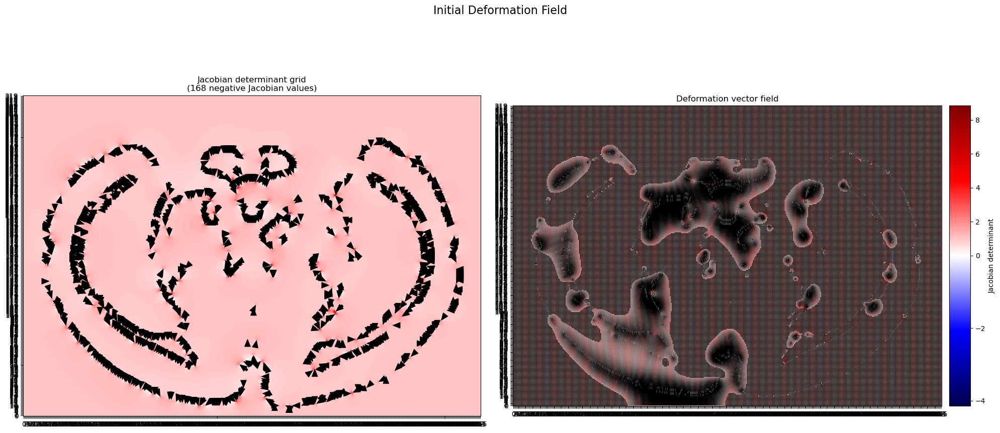

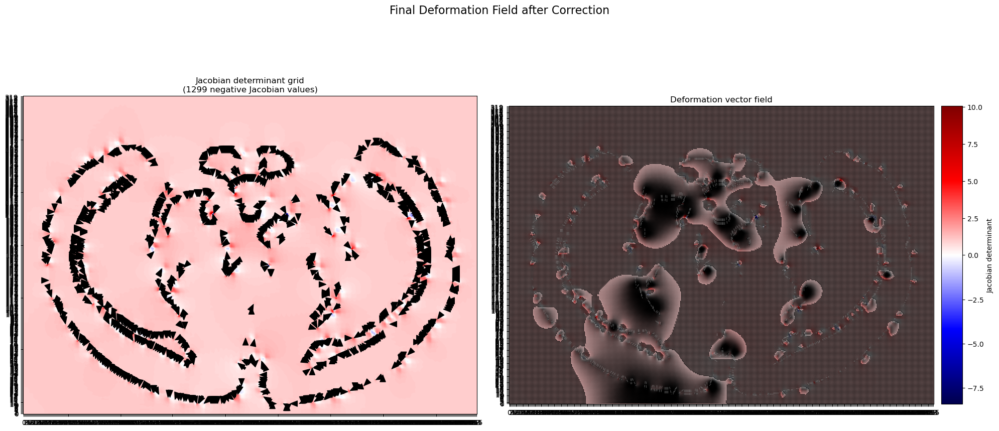

In [15]:
start = time.time()

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

msample = np.load(mpoints_path)
fsample = np.load(fpoints_path)
fixed_sample = np.zeros((1, 320, 456))

# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 350

# use 
mask = msample[:,0]==slice_no
new_mpoints = msample[mask].copy()
new_mpoints[:, 0] = 0

mask = fsample[:,0]==slice_no
new_fpoints = fsample[mask].copy()
new_fpoints[:,0] = 0

deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, new_mpoints, new_fpoints)
#print(f'deformation shape: {deformation_i.shape}')
#print(deformation_i.dtype)

# Plot the final deformation
plot_deformation(
    msample=new_mpoints,
    fsample=new_fpoints,
    deformation=deformation_i,
    title="Initial Deformation Field",
    figsize=(20, 10),
    show_values=False,
    show_points=False
)

# Load corrected downscaled deformation
scale_factor = 0.2

# Downscale the deformation field
deformation_downscaled = scale_dvf_numpy(deformation_i, new_size=(int(320 * scale_factor), int(456 * scale_factor)))

# Solve the correction with the downscaled deformation
deformation_downscaled_corrected = np.load("output/phi_corrected.npy")
#np.save("output/deformation_downscaled_corrected.npy", deformation_downscaled_corrected)

# Get the difference 
deformation_downscaled_diff = deformation_downscaled_corrected - deformation_downscaled

# Rescale to original size
deformation_rescaled_diff = scale_dvf_numpy(deformation_downscaled_diff, new_size=(320, 456))

# Apply to the original deformation field
deformation_final = deformation_i + deformation_rescaled_diff

# Plot the final deformation
plot_deformation(
    msample=new_mpoints,
    fsample=new_fpoints,
    deformation=deformation_final,
    title="Final Deformation Field after Correction",
    figsize=(20, 10),
    show_values=False,
    show_points=False
)

## Run downscaling with 0.2

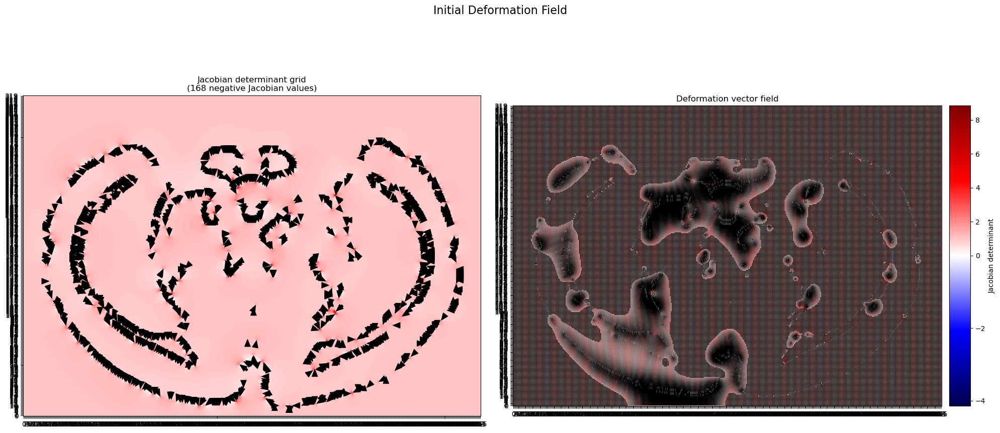

deformation_i shape: (3, 1, 48, 68), phi_init shape: (2, 48, 68)


In [ ]:
start = time.time()

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

msample = np.load(mpoints_path)
fsample = np.load(fpoints_path)
fixed_sample = np.zeros((1, 320, 456))

# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 350

# use 
mask = msample[:,0]==slice_no
new_mpoints = msample[mask].copy()
new_mpoints[:, 0] = 0

mask = fsample[:,0]==slice_no
new_fpoints = fsample[mask].copy()
new_fpoints[:,0] = 0

deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, new_mpoints, new_fpoints)
#print(f'deformation shape: {deformation_i.shape}')
#print(deformation_i.dtype)

# Plot the final deformation
plot_deformation(
    msample=new_mpoints,
    fsample=new_fpoints,
    deformation=deformation_i,
    title="Initial Deformation Field",
    figsize=(20, 10),
    show_values=False,
    show_points=False
)

# Load corrected downscaled deformation

# Shrink the samples to a smaller resolution for faster processing
scale_factor = 0.2

# Create a fixed sample with smaller resolution
fixed_sample = np.zeros((1, int(320 * scale_factor), int(456 * scale_factor)))  # Adjusted size for smaller resolution

# Downscale the deformation field
deformation_downscaled = scale_dvf_numpy(deformation_i, new_size=(int(320 * scale_factor), int(456 * scale_factor)))

# Solve the correction with the downscaled deformation
deformation_downscaled_corrected, jacobians = full_slsqp(deformation_downscaled, 'SLSQP')
np.save("output/deformation_downscaled_corrected_0.2.npy", deformation_downscaled_corrected)

# Get the difference 
deformation_downscaled_diff = deformation_downscaled_corrected - deformation_downscaled

# Rescale to original size
deformation_rescaled_diff = scale_dvf_numpy(deformation_downscaled_diff, new_size=(320, 456))

# Apply to the original deformation field
deformation_final = deformation_i + deformation_rescaled_diff

# Plot the final deformation
plot_deformation(
    msample=new_mpoints,
    fsample=new_fpoints,
    deformation=deformation_final,
    title="Final Deformation Field after Correction",
    figsize=(20, 10),
    show_values=False,
    show_points=False
)

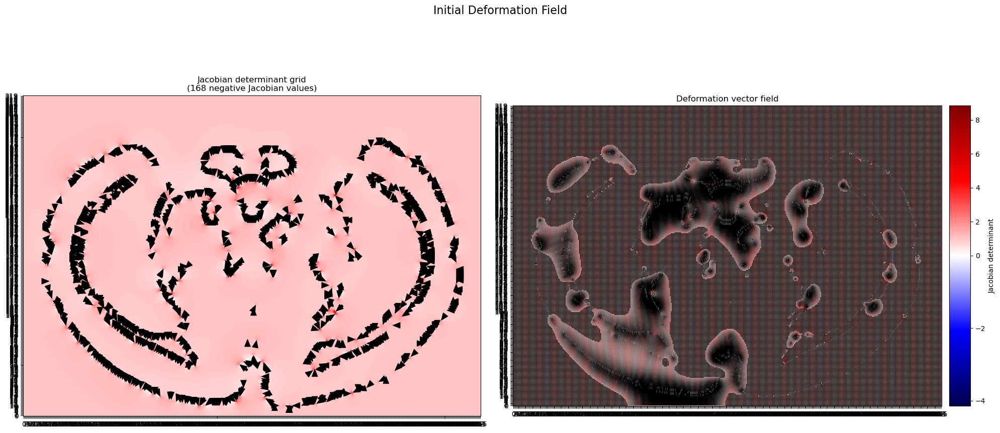

In [13]:
# Plot the final deformation
plot_deformation(
    msample=new_mpoints,
    fsample=new_fpoints,
    deformation=deformation_i,
    title="Initial Deformation Field",
    figsize=(20, 10),
    show_values=False,
    show_points=False
)

# Time benchmarks

In [11]:
from matplotlib import colors as mcolors
from mpl_toolkits.axes_grid1 import make_axes_locatable


In [9]:

def run_correction_only(msample, fsample, deformation_i, methodName='SLSQP'):
    """Modified function to run correction only without Laplacian computation."""
    phi_corrected, jacobians = full_slsqp(deformation_i, methodName)
    #plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
    return phi_corrected, jacobians


def benchmark_slsqp_time(msample, fsample, fixed_sample, scale_factor=1.0):
    # Scale the moving and fixed samples
    mcopy = msample.copy()
    fcopy = fsample.copy()
    fixed_sample_copy = np.zeros((1, int(fixed_sample.shape[1] * scale_factor), int(fixed_sample.shape[2] * scale_factor)))  # Adjusted size for smaller resolution

    # Multiply every coordinate and make sure to round them
    mcopy[:, :] = np.round(mcopy[:, :] * scale_factor).astype(int)
    fcopy[:, :] = np.round(fcopy[:, :] * scale_factor).astype(int)
    
    deformation_i, _, _, _, _ = laplacian.sliceToSlice3DLaplacian(fixed_sample_copy, mcopy, fcopy)

    # Run the Laplacian and correction
    start = time.time()
    phi_corrected, jacobians = run_correction_only(mcopy, fcopy, deformation_i)
    elapsed = time.time() - start
    print(f"Time taken for optimization on {fixed_sample_copy.shape[1:]}: {elapsed} seconds")
    return elapsed

In [15]:
# Create a sample moving and fixed point set
msample = np.array([
    [0, 1, 2],
    [0, 1, 6],
    [0, 7, 5],
    [0, 5, 3],
    [0, 7, 1],
    [0, 3, 7],
])
fsample = np.array([
    [0, 3, 6],
    [0, 3, 2],
    [0, 5, 5],
    [0, 7, 3],
    [0, 3, 1],
    [0, 9, 7],
])
fixed_sample = np.zeros((1, 10, 10))

benchmarks = [0.5, 0.7, 1.1, 1.3, 1.5, 1.7, 1.9, 2.1, 2.3, 2.5, 2.7, 2.9, 3.1]  # Scale factors to test
time_counts = []  # Keep track of time for each scale factor

## Run benchmarks

deformation_i shape: (3, 1, 5, 5), phi_init shape: (2, 5, 5)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.1549371008662137
            Iterations: 13
            Function evaluations: 677
            Gradient evaluations: 13
OP result error: 1.1549371008662137
Deviation from initial = 1.1549371008662137
Changed number of -ve jacobians from 4 to 0
Time taken for full SLSQP optimisation: 1.8975694179534912s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -1.999814  1.999814 -1.999960  1.999960 -0.632144  2.070291
final   -1.741377  2.011123 -1.998347  1.993975  0.010000  1.981894
meshgrid shape for plot: (5, 5)
Time taken for optimization on (5, 5): 1.9340648651123047 seconds
deformation_i shape: (3, 1, 5, 5), phi_init shape: (2, 5, 5)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.1549371008662137
    

C:\Users\Andy\AppData\Local\Temp\ipykernel_32728\2651218989.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(nrows=2, ncols=2, figsize=figsize)


Optimization terminated successfully    (Exit mode 0)
            Current function value: 2.6780979480254197
            Iterations: 13
            Function evaluations: 3169
            Gradient evaluations: 13
OP result error: 2.6780979480254197
Deviation from initial = 2.67809794802542
Changed number of -ve jacobians from 15 to 0
Time taken for full SLSQP optimisation: 8.097917556762695s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -4.999724  4.999724 -6.999401  4.999572 -1.482733  4.050929
final   -4.491452  4.743416 -6.687147  4.564658  0.010000  3.424428
meshgrid shape for plot: (11, 11)
Time taken for optimization on (11, 11): 8.127918720245361 seconds
deformation_i shape: (3, 1, 11, 11), phi_init shape: (2, 11, 11)
Optimization terminated successfully    (Exit mode 0)
            Current function value: 2.6780979480254197
            Iterations: 13
            Function evaluations

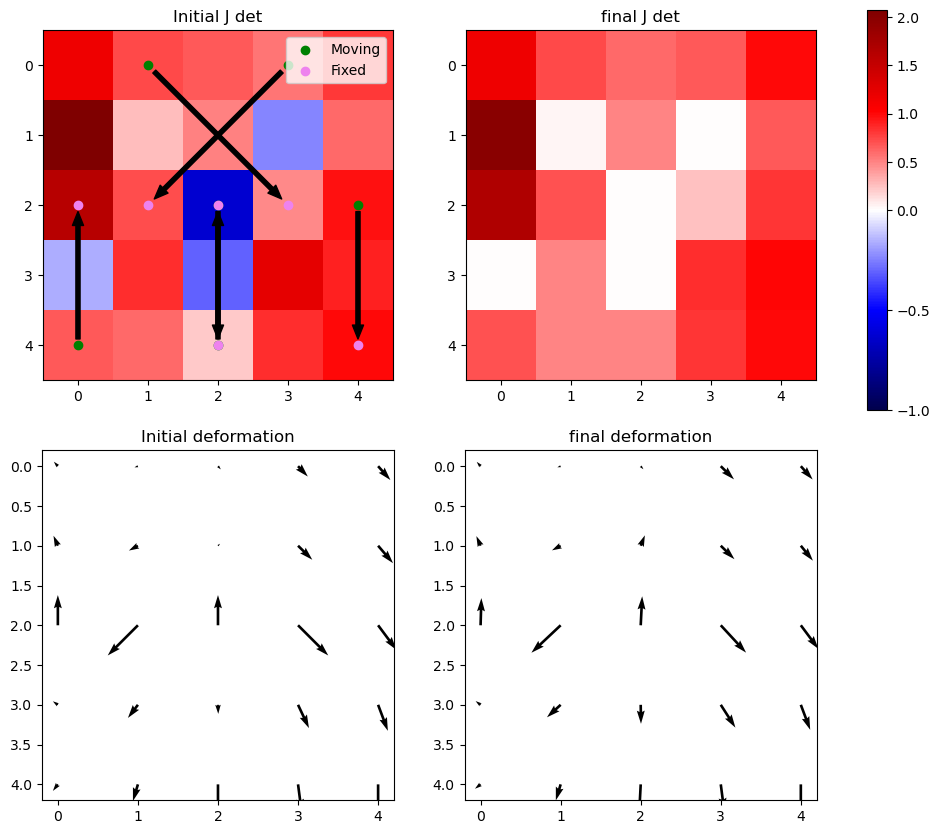

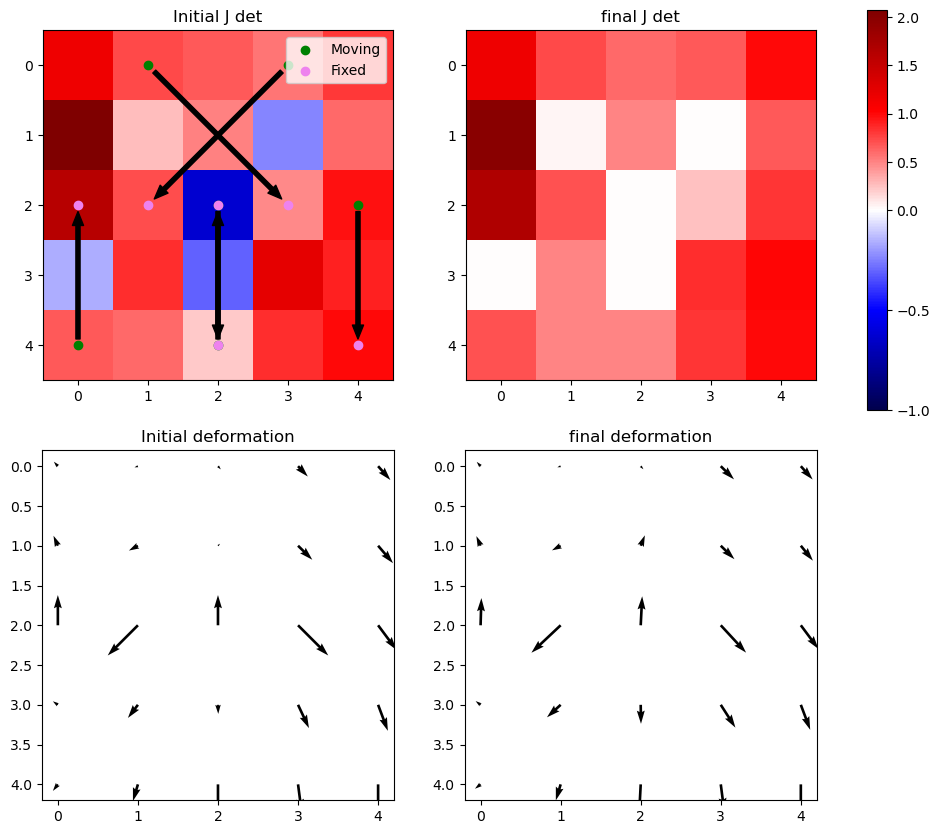

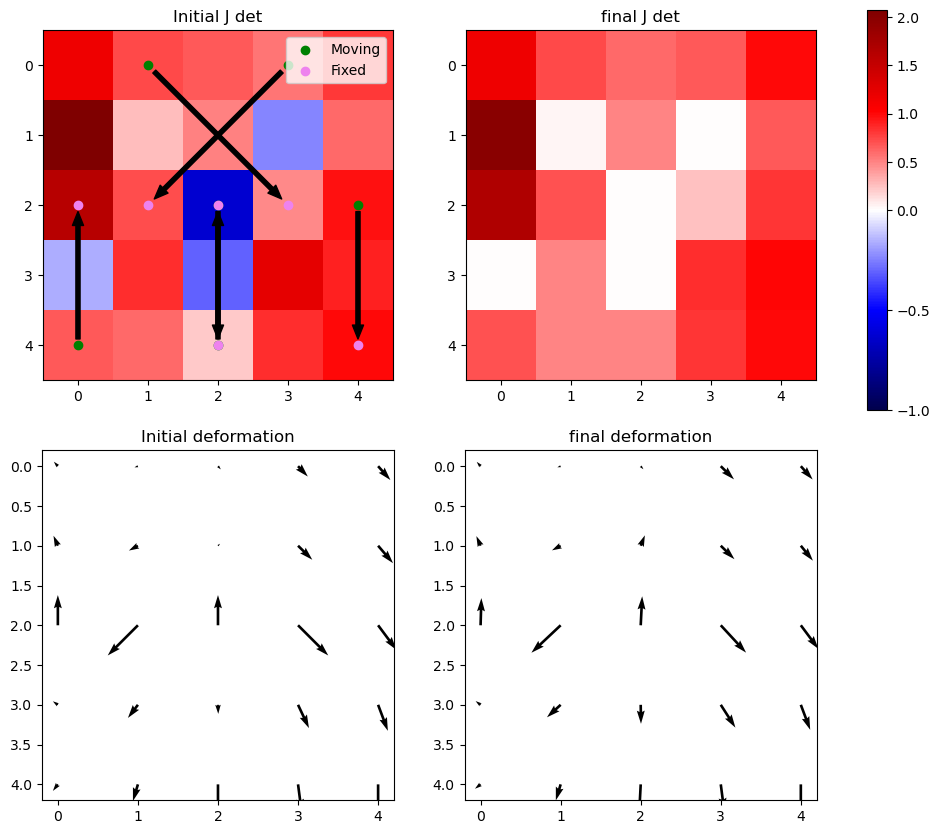

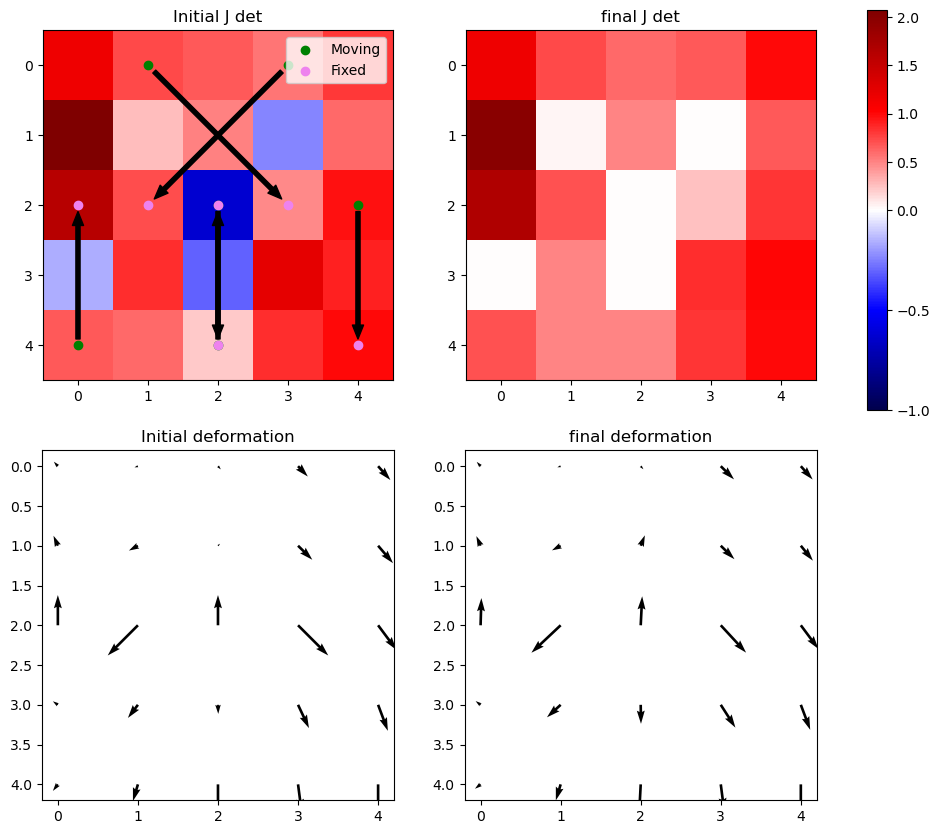

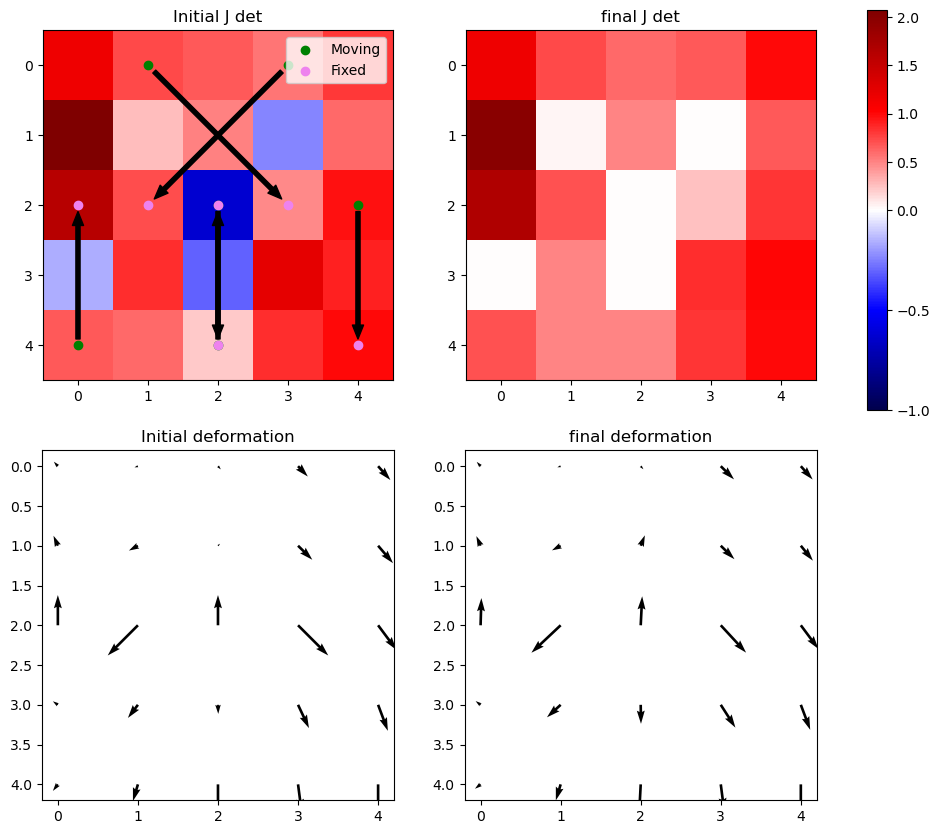

...

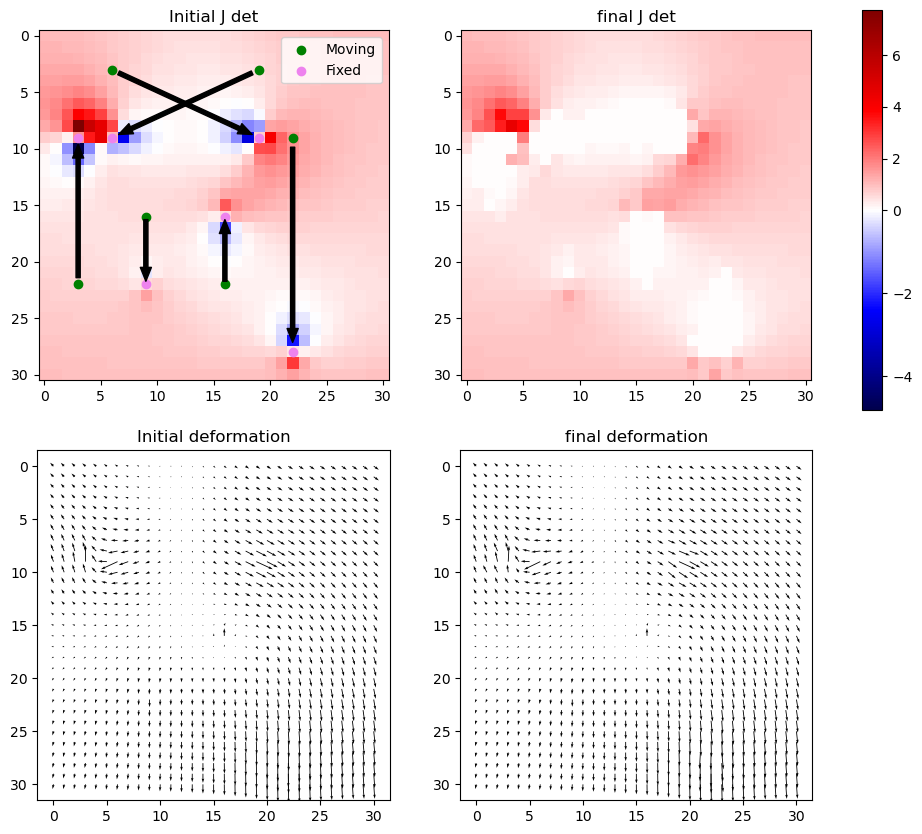

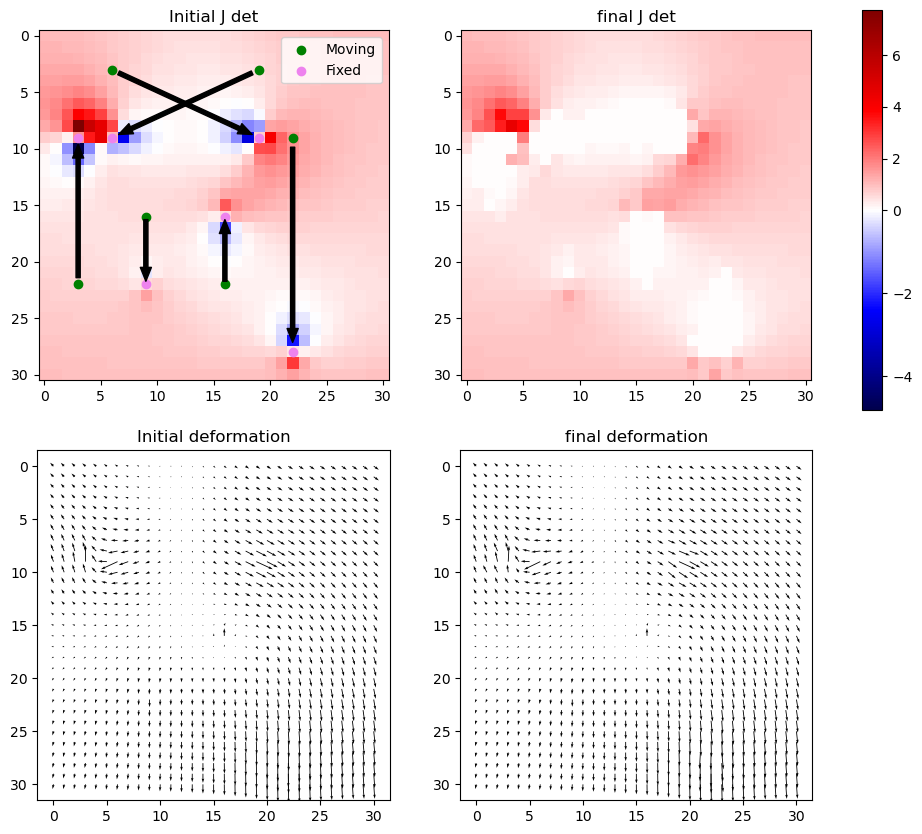

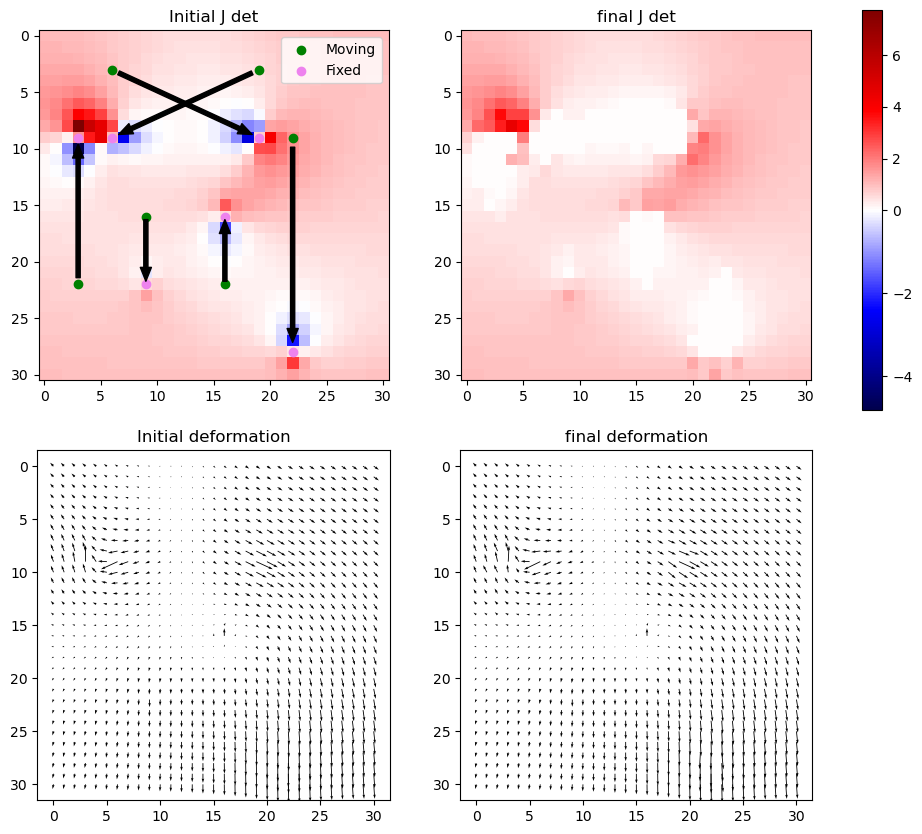

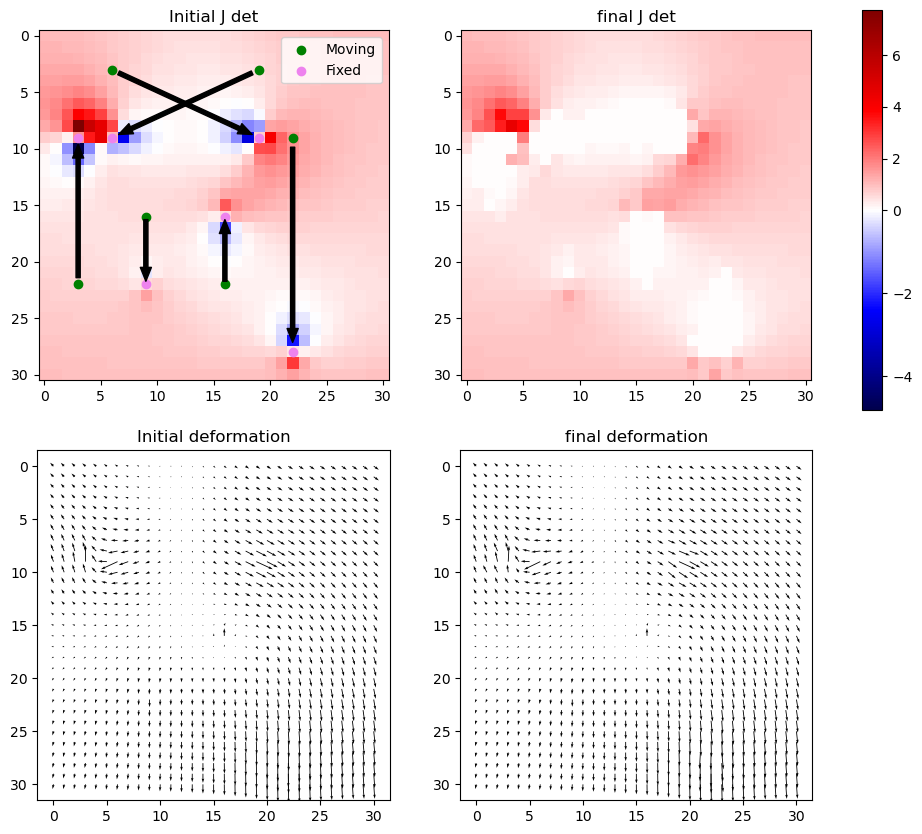

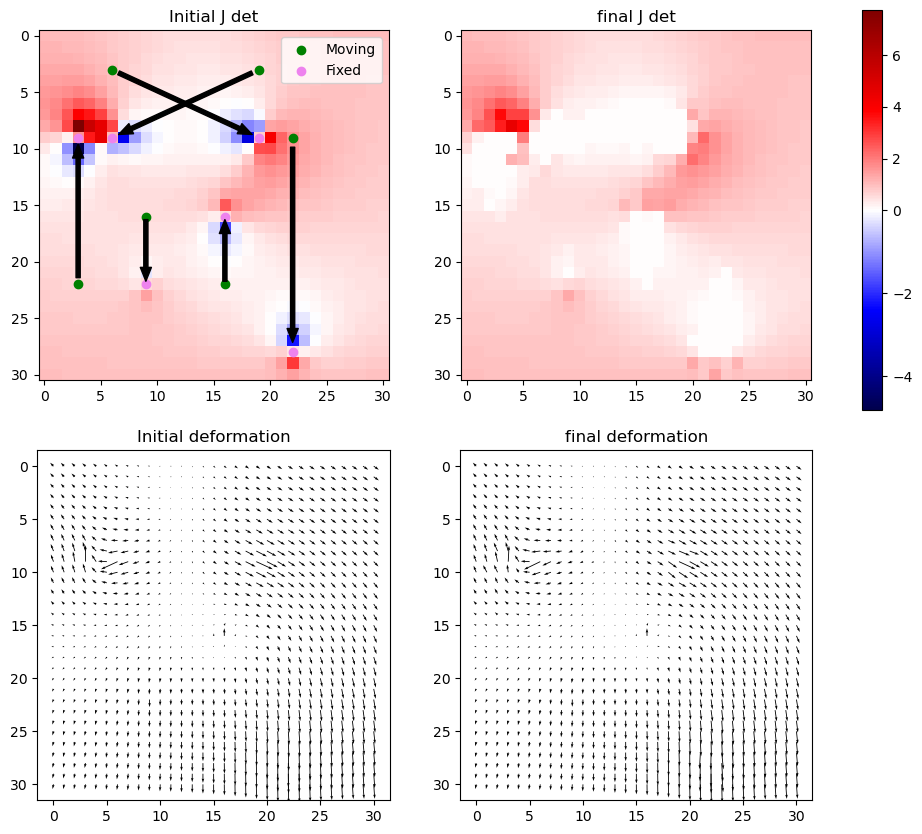

In [16]:
for scale_factor in benchmarks:
    for i in range(10):
        curr_elapsed = [] # Reset for each scale factor
        elapsed = benchmark_slsqp_time(msample, fsample, fixed_sample, scale_factor=scale_factor)
        curr_elapsed.append(elapsed)
    time_counts.append(np.mean(curr_elapsed))  # Store the average time for this scale factor

In [18]:
print(benchmarks)

[0.5, 0.7, 1.1, 1.3, 1.5, 1.7, 1.9, 2.1, 2.3, 2.5, 2.7, 2.9, 3.1]


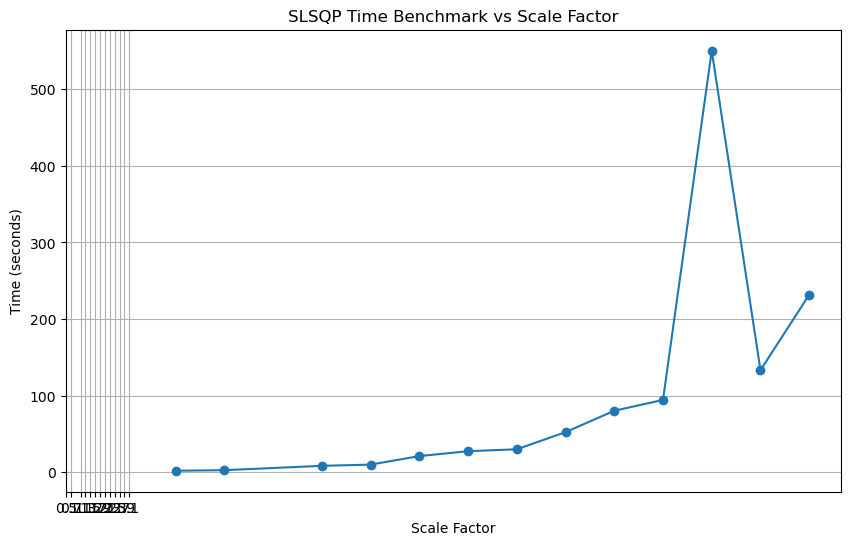

In [17]:
# Plot the time taken for each scale factor
plt.figure(figsize=(10, 6))
plt.plot([int(b * 10) for b in benchmarks], time_counts, marker='o')
plt.title('SLSQP Time Benchmark vs Scale Factor')
plt.xlabel('Scale Factor')
plt.ylabel('Time (seconds)')
plt.grid(True)
plt.xticks(benchmarks)
plt.show()

In [ ]:
### Try downsampling a large deformation field instead and running SLSQP on iterative downscaled versions